In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t60p60.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los60.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

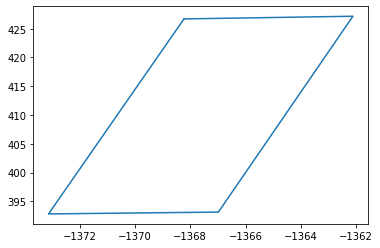

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

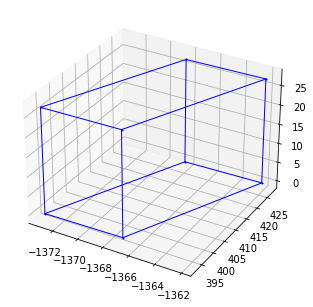

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▌                                                                              | 68/8644 [00:00<00:40, 210.72it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:16<00:00, 509.01it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+ 21*math.log10(d_3D)+ 20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [21]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [22]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=4.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [23]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= -6.77     #8- 10* math.log10(30) #N=30, for 38dbm=8db
#         LBuildingLoss=1
        interface1=TXPower+ G_5G_R-pathloss_UMi- LBodyLoss + G_Rx_5G
        return interface1,pathloss_UMi

In [24]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface2=TXPower+ G_5G_R-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa

In [25]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("fss_phi_difference:", fss_phi_difference)

        G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= -6.77     #8- 10* math.log10(30) #N=30,  for 38dbm=8db
#         LBuildingLoss=1
        interface3=TXPower+ G_5G_R-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [26]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [27]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e3, interference_type=None)

x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, 0)
        FSS_Y = np.append(FSS_Y, 0)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e3, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 10)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W=np.empty([0])
    interface_UMa_W=np.empty([0])
    interface_RMa_W=np.empty([0])
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            if output: print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                     interface_UMi_W=np.append(interface_UMi_W,0)
#                     interface_UMa_W=np.append(interface_UMa_W,0)
#                     interface_RMa_W=np.append(interface_RMa_W,0)
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

                    theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    theta_tilt=10
                    
                    
#                   

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j],theta_tilt,phi_scan)
                        if output: print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference uma:", interfaceuma, "pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         if output: print("interference rma:", interfacerma, "pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)

        interface_UMi_W = np.append(interface_UMi_W, np.sum(10 ** (interface_UMi_BS / 10)))
        interface_UMa_W = np.append(interface_UMa_W, np.sum(10 ** (interface_UMa_BS / 10)))
        interface_RMa_W = np.append(interface_RMa_W, np.sum(10 ** (interface_RMa_BS / 10)))
              
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi = interface_UMi_W / Noise_W
    if output: print('I/N UMi:', I_N_UMi)
    I_N_UMa = interface_UMa_W / Noise_W
    if output: print('I/N UMa:', I_N_UMa)      
    I_N_RMa = interface_RMa_W / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight
        

In [28]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
    if coarse:
        theta = round(theta, rounding_precision)
        phi = round(phi, rounding_precision)
    if (theta, phi) in saved_tp:
        # print(f'match found for ({theta}, {phi}), using that')
        return saved_tp.get((theta, phi))
    
    
    
    # return max_parameters
    # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
    result = optimize.brute(
        lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
        # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
        ranges = [(-90, 90), (-180, 180)]
        
    )
    saved_tp[(theta, phi)] = tuple(x for x in result)
    
    return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
    summation = 0
    # weighting multiplied by the superposition vector
    for n in range(1, rows+1):
        for m in range(1, cols+1):
            # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
            summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

    return abs(summation)**2

# antenna gain of 5G base station (represented by a single beam i)
def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
    beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

    return gain_antenna_element(theta, phi) + \
           10 * math.log10(beam_pattern)

# space refers to D/λ
def get_phi_min(space) -> float:
    # Rec. ITU-R S.465-6
    if space >= 50:
        return max(1.0, 100 * (1 / space))
    else:
        return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
def gain_fss_s1428(phi, phi_min) -> float:

    if 0 < phi < phi_min:
        return 32 - 25 * math.log10(phi_min)
    elif phi_min <= phi < 48:
        return 32 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -10

    # This function is only defined where phi is within (0, 180]
    raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [ ]:
from tqdm import tqdm
distance_RMa, I_N_RMa_W, I_N_RMa_noAverage, distance_UMa, I_N_UMa_W, I_N_UMa_noAverage, distance_UMi, I_N_UMi_W, I_N_UMi_noAverage, line_of_sight = [np.empty([0]) for x in range(10)]
simulation_count = 10
for i in tqdm(range(simulation_count)):
   distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)

   distance_RMa = np.append(distance_RMa, distance_RMa_single)
   # print(I_N_RMa_single_W)
   I_N_RMa_W = np.append(I_N_RMa_W, I_N_RMa_single_W)
   I_N_RMa_noAverage = np.append(I_N_RMa_noAverage, 10 * np.log10(I_N_RMa_single_W))
   
   distance_UMa = np.append(distance_UMa, distance_UMa_single)
   I_N_UMa_W = np.append(I_N_UMa_W, I_N_UMa_single_W)
   I_N_UMa_noAverage = np.append(I_N_UMa_noAverage, 10 * np.log10(I_N_UMa_single_W))

   distance_UMi = np.append(distance_UMi, distance_UMi_single)
   I_N_UMi_W = np.append(I_N_UMi_W, I_N_UMi_single_W)
   I_N_UMi_noAverage = np.append(I_N_UMi_noAverage, 10 * np.log10(I_N_UMi_single_W))
    
   line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0
    
I_N_RMa = 10 * np.log10(np.average(I_N_RMa_W))
I_N_UMa = 10 * np.log10(np.average(I_N_UMa_W))
I_N_UMi = 10 * np.log10(np.average(I_N_UMi_W))

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 40%|██████████████████████████████▌                                              | 3241/8177 [00:07<00:15, 314.35it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7029/8177 [00:14<00:02, 410.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.10it/s]

 29%|██████████████████████▏                                                      | 2357/8177 [00:05<00:14, 398.10it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5961/8177 [00:12<00:04, 524.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.88it/s]

 16%|████████████▎                                                                | 1306/8177 [00:03<00:13, 522.99it/s]


 61%|██████████████████████████████████████████████▋                              | 4961/8177 [00:10<00:06, 512.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.80it/s]

  3%|██▋                                                                           | 285/8177 [00:00<00:19, 405.51it/s]


 48%|█████████████████████████████████████▎                                       | 3959/8177 [00:08<00:07, 539.78it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7724/8177 [00:16<00:01, 349.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.58it/s]

 37%|████████████████████████████▎                                                | 3013/8177 [00:06<00:13, 378.02it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:13<00:02, 535.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.09it/s]

 26%|███████████████████▋                                                         | 2094/8177 [00:04<00:12, 487.52it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5823/8177 [00:12<00:04, 491.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.21it/s]

 13%|██████████▏                                                                  | 1079/8177 [00:02<00:13, 520.35it/s]


 57%|███████████████████████████████████████████▊                                 | 4653/8177 [00:10<00:06, 547.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.25it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:30, 266.05it/s]


 41%|███████████████████████████████▌                                             | 3357/8177 [00:07<00:12, 399.60it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7052/8177 [00:15<00:02, 396.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.31it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:05<00:12, 453.60it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5910/8177 [00:12<00:04, 494.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.95it/s]

 14%|██████████▊                                                                  | 1144/8177 [00:02<00:15, 442.43it/s]


 59%|█████████████████████████████████████████████▏                               | 4797/8177 [00:10<00:06, 515.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.68it/s]

  2%|█▎                                                                            | 142/8177 [00:00<00:32, 248.92it/s]


 45%|██████████████████████████████████▋                                          | 3687/8177 [00:08<00:08, 543.03it/s]


 91%|█████████████████████████████████████████████████████████████████████▊       | 7415/8177 [00:15<00:01, 619.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.12it/s]

 32%|████████████████████████▋                                                    | 2620/8177 [00:05<00:11, 492.79it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6208/8177 [00:13<00:03, 520.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.07it/s]

 18%|██████████████▏                                                              | 1504/8177 [00:03<00:11, 559.37it/s]


 64%|█████████████████████████████████████████████████▌                           | 5260/8177 [00:11<00:05, 524.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.44it/s]

  6%|████▉                                                                         | 517/8177 [00:01<00:22, 344.21it/s]


 52%|███████████████████████████████████████▊                                     | 4227/8177 [00:09<00:07, 527.63it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7991/8177 [00:16<00:00, 523.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.34it/s]

 39%|█████████████████████████████▉                                               | 3178/8177 [00:07<00:13, 376.56it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6943/8177 [00:14<00:02, 510.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.12it/s]

 27%|████████████████████▋                                                        | 2200/8177 [00:04<00:15, 374.03it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5870/8177 [00:12<00:04, 507.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.30it/s]

 14%|██████████▊                                                                  | 1147/8177 [00:02<00:16, 438.56it/s]


 59%|█████████████████████████████████████████████▍                               | 4822/8177 [00:10<00:06, 518.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.51it/s]

  2%|█▊                                                                            | 187/8177 [00:00<00:26, 299.25it/s]


 46%|███████████████████████████████████                                          | 3727/8177 [00:08<00:07, 571.44it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7507/8177 [00:15<00:01, 609.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.68it/s]

 33%|█████████████████████████▌                                                   | 2717/8177 [00:06<00:09, 546.03it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6337/8177 [00:13<00:03, 547.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.36it/s]

 20%|███████████████                                                              | 1605/8177 [00:03<00:14, 458.33it/s]


 64%|█████████████████████████████████████████████████▎                           | 5237/8177 [00:11<00:05, 501.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.26it/s]

  6%|████▌                                                                         | 483/8177 [00:01<00:22, 339.81it/s]


 50%|██████████████████████████████████████▊                                      | 4119/8177 [00:09<00:07, 541.26it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7811/8177 [00:16<00:00, 401.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.71it/s]

 37%|████████████████████████████▊                                                | 3066/8177 [00:06<00:13, 389.66it/s]


 83%|████████████████████████████████████████████████████████████████             | 6800/8177 [00:14<00:02, 526.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.01it/s]

 26%|████████████████████▏                                                        | 2141/8177 [00:04<00:12, 490.21it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5813/8177 [00:12<00:04, 505.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.40it/s]

 13%|██████████▎                                                                  | 1089/8177 [00:02<00:13, 512.27it/s]


 59%|█████████████████████████████████████████████                                | 4788/8177 [00:10<00:07, 465.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.71it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:33, 242.91it/s]


 45%|██████████████████████████████████▊                                          | 3700/8177 [00:08<00:08, 557.38it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7439/8177 [00:15<00:01, 622.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.56it/s]

 33%|█████████████████████████▍                                                   | 2701/8177 [00:06<00:10, 540.68it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6285/8177 [00:13<00:03, 549.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.40it/s]

 18%|█████████████▊                                                               | 1465/8177 [00:03<00:12, 539.02it/s]


 63%|████████████████████████████████████████████████▎                            | 5133/8177 [00:11<00:06, 476.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.02it/s]

  5%|███▊                                                                          | 403/8177 [00:01<00:20, 376.92it/s]


 49%|█████████████████████████████████████▋                                       | 3996/8177 [00:08<00:08, 509.89it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7658/8177 [00:16<00:01, 319.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.43it/s]

 35%|███████████████████████████▎                                                 | 2895/8177 [00:06<00:11, 448.28it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6427/8177 [00:13<00:03, 544.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.29it/s]

 21%|███████████████▊                                                             | 1682/8177 [00:03<00:12, 526.09it/s]


 64%|█████████████████████████████████████████████████▏                           | 5229/8177 [00:11<00:05, 496.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.97it/s]

  5%|████                                                                          | 425/8177 [00:01<00:21, 360.26it/s]


 47%|████████████████████████████████████▍                                        | 3866/8177 [00:09<00:08, 504.63it/s]


 91%|██████████████████████████████████████████████████████████████████████▍      | 7477/8177 [00:16<00:01, 565.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 452.74it/s]

 32%|████████████████████████▋                                                    | 2623/8177 [00:06<00:11, 477.11it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6111/8177 [00:13<00:03, 530.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.34it/s]

 16%|████████████                                                                 | 1282/8177 [00:03<00:13, 501.61it/s]


 59%|█████████████████████████████████████████████▊                               | 4860/8177 [00:10<00:06, 488.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.11it/s]

  1%|█                                                                             | 116/8177 [00:00<00:32, 245.50it/s]


 45%|██████████████████████████████████▌                                          | 3668/8177 [00:08<00:07, 592.42it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7465/8177 [00:15<00:01, 588.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.17it/s]

 34%|██████████████████████████▍                                                  | 2803/8177 [00:06<00:10, 517.56it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6515/8177 [00:13<00:03, 524.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.88it/s]

 22%|█████████████████                                                            | 1813/8177 [00:04<00:11, 554.73it/s]


 67%|███████████████████████████████████████████████████▋                         | 5495/8177 [00:11<00:04, 549.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.01it/s]

  9%|██████▉                                                                       | 730/8177 [00:02<00:15, 479.01it/s]


 55%|██████████████████████████████████████████▎                                  | 4491/8177 [00:09<00:06, 586.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.71it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 42%|████████████████████████████████▌                                            | 3460/8177 [00:07<00:10, 471.49it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7224/8177 [00:14<00:02, 455.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.49it/s]

 32%|████████████████████████▋                                                    | 2622/8177 [00:05<00:11, 498.35it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6334/8177 [00:13<00:03, 556.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 484.24it/s]

 20%|███████████████▌                                                             | 1649/8177 [00:03<00:12, 530.16it/s]


 65%|█████████████████████████████████████████████████▊                           | 5293/8177 [00:11<00:05, 512.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.60it/s]

  6%|█████                                                                         | 525/8177 [00:01<00:21, 355.42it/s]


 51%|███████████████████████████████████████▌                                     | 4206/8177 [00:09<00:07, 511.62it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7944/8177 [00:16<00:00, 473.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.78it/s]

 39%|█████████████████████████████▊                                               | 3168/8177 [00:07<00:13, 372.44it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6847/8177 [00:14<00:02, 530.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.24it/s]

 25%|███████████████████▏                                                         | 2040/8177 [00:04<00:13, 467.12it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5693/8177 [00:12<00:04, 550.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.48it/s]

 11%|████████▏                                                                     | 859/8177 [00:02<00:16, 446.44it/s]


 56%|███████████████████████████████████████████▏                                 | 4589/8177 [00:10<00:06, 550.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.44it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:30, 268.32it/s]


 43%|████████████████████████████████▊                                            | 3481/8177 [00:08<00:09, 478.00it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7206/8177 [00:15<00:02, 444.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.35it/s]

 30%|███████████████████████                                                      | 2443/8177 [00:05<00:14, 395.97it/s]


 74%|█████████████████████████████████████████████████████████                    | 6056/8177 [00:12<00:03, 556.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.99it/s]

 16%|████████████▍                                                                | 1322/8177 [00:03<00:12, 534.73it/s]


 61%|██████████████████████████████████████████████▊                              | 4974/8177 [00:10<00:06, 490.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.79it/s]

  4%|███                                                                           | 323/8177 [00:00<00:19, 403.96it/s]


 47%|████████████████████████████████████▌                                        | 3881/8177 [00:08<00:07, 551.01it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7669/8177 [00:16<00:01, 351.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.99it/s]

 36%|███████████████████████████▊                                                 | 2954/8177 [00:06<00:13, 391.62it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6629/8177 [00:13<00:03, 467.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.63it/s]

 23%|██████████████████                                                           | 1918/8177 [00:04<00:12, 498.08it/s]


 68%|████████████████████████████████████████████████████▎                        | 5559/8177 [00:11<00:05, 521.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.91it/s]

  9%|███████▎                                                                      | 761/8177 [00:02<00:16, 461.19it/s]


 56%|███████████████████████████████████████████▏                                 | 4583/8177 [00:09<00:06, 554.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.77it/s]

  1%|▌                                                                              | 57/8177 [00:00<00:30, 266.47it/s]


 44%|██████████████████████████████████▏                                          | 3634/8177 [00:08<00:07, 596.43it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7470/8177 [00:15<00:01, 579.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.68it/s]

 34%|██████████████████████████▍                                                  | 2812/8177 [00:06<00:10, 511.75it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6531/8177 [00:13<00:03, 526.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 487.22it/s]

 23%|█████████████████▊                                                           | 1888/8177 [00:04<00:12, 514.31it/s]


 69%|████████████████████████████████████████████████████▊                        | 5602/8177 [00:11<00:04, 541.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 488.05it/s]

 10%|███████▋                                                                      | 810/8177 [00:02<00:17, 423.08it/s]


 56%|███████████████████████████████████████████▏                                 | 4590/8177 [00:09<00:06, 554.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.78it/s]

  1%|▌                                                                              | 57/8177 [00:00<00:30, 263.12it/s]


 43%|████████████████████████████████▊                                            | 3481/8177 [00:07<00:09, 490.13it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7307/8177 [00:15<00:01, 526.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.77it/s]

 32%|████████████████████████▋                                                    | 2621/8177 [00:05<00:11, 497.38it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6342/8177 [00:13<00:03, 572.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.53it/s]

 20%|███████████████▋                                                             | 1670/8177 [00:03<00:12, 502.21it/s]


 64%|█████████████████████████████████████████████████▏                           | 5230/8177 [00:11<00:05, 493.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.45it/s]

  5%|███▊                                                                          | 404/8177 [00:01<00:21, 367.71it/s]


 48%|████████████████████████████████████▉                                        | 3920/8177 [00:08<00:07, 550.33it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7593/8177 [00:16<00:01, 473.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.52it/s]

 34%|██████████████████████████▎                                                  | 2794/8177 [00:06<00:10, 517.85it/s]


 78%|████████████████████████████████████████████████████████████                 | 6376/8177 [00:13<00:03, 545.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.08it/s]

 20%|███████████████▎                                                             | 1625/8177 [00:03<00:13, 473.83it/s]


 65%|█████████████████████████████████████████████████▊                           | 5296/8177 [00:11<00:05, 502.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.92it/s]

  6%|████▉                                                                         | 518/8177 [00:01<00:22, 343.61it/s]


 52%|███████████████████████████████████████▊                                     | 4229/8177 [00:09<00:07, 537.81it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7927/8177 [00:16<00:00, 476.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.25it/s]

 39%|█████████████████████████████▊                                               | 3162/8177 [00:07<00:12, 385.83it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6908/8177 [00:14<00:02, 528.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.42it/s]

 27%|█████████████████████▏                                                       | 2248/8177 [00:04<00:13, 427.02it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5981/8177 [00:12<00:04, 532.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 488.10it/s]

 16%|████████████▍                                                                | 1320/8177 [00:03<00:13, 524.51it/s]


 62%|███████████████████████████████████████████████▍                             | 5044/8177 [00:10<00:05, 534.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.49it/s]

  5%|███▌                                                                          | 376/8177 [00:01<00:20, 388.81it/s]


 50%|██████████████████████████████████████▏                                      | 4051/8177 [00:08<00:07, 526.20it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7816/8177 [00:16<00:00, 409.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.35it/s]

 37%|████████████████████████████▍                                                | 3024/8177 [00:07<00:14, 366.01it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6654/8177 [00:14<00:03, 472.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.19it/s]

 24%|██████████████████▋                                                          | 1978/8177 [00:04<00:11, 527.60it/s]


 68%|████████████████████████████████████████████████████▍                        | 5569/8177 [00:11<00:04, 552.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.71it/s]

 10%|███████▋                                                                      | 808/8177 [00:02<00:17, 422.16it/s]


 56%|██████████████████████████████████████████▊                                  | 4544/8177 [00:09<00:06, 558.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.16it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:28, 281.32it/s]


 41%|███████████████████████████████▉                                             | 3392/8177 [00:07<00:10, 456.60it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7138/8177 [00:15<00:02, 412.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.05it/s]

 29%|██████████████████████▎                                                      | 2375/8177 [00:05<00:18, 320.79it/s]


 74%|█████████████████████████████████████████████████████████                    | 6055/8177 [00:12<00:03, 554.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.04it/s]

 16%|████████████▎                                                                | 1313/8177 [00:03<00:13, 521.09it/s]


 61%|███████████████████████████████████████████████▎                             | 5027/8177 [00:10<00:06, 521.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.15it/s]

  4%|███▍                                                                          | 365/8177 [00:01<00:19, 391.57it/s]


 48%|█████████████████████████████████████▎                                       | 3962/8177 [00:08<00:07, 549.53it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7706/8177 [00:16<00:01, 324.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.42it/s]

 36%|███████████████████████████▉                                                 | 2971/8177 [00:06<00:13, 373.34it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6688/8177 [00:13<00:03, 487.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.51it/s]

 24%|██████████████████▋                                                          | 1985/8177 [00:04<00:11, 538.41it/s]


 69%|█████████████████████████████████████████████████████                        | 5638/8177 [00:11<00:04, 547.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.21it/s]

 11%|████████▎                                                                     | 874/8177 [00:02<00:15, 466.32it/s]


 57%|███████████████████████████████████████████▌                                 | 4630/8177 [00:09<00:06, 543.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.24it/s]

  1%|▊                                                                              | 85/8177 [00:00<00:37, 216.43it/s]


 45%|██████████████████████████████████▋                                          | 3687/8177 [00:08<00:07, 576.74it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7503/8177 [00:15<00:01, 607.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.78it/s]

 34%|██████████████████████████▏                                                  | 2777/8177 [00:06<00:10, 539.64it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6449/8177 [00:13<00:03, 543.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.02it/s]

 22%|████████████████▌                                                            | 1763/8177 [00:03<00:11, 548.24it/s]


 66%|███████████████████████████████████████████████████                          | 5416/8177 [00:11<00:05, 543.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.30it/s]

  8%|██████▎                                                                       | 666/8177 [00:01<00:18, 403.61it/s]


 56%|██████████████████████████████████████████▊                                  | 4544/8177 [00:09<00:06, 564.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 486.19it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:28, 281.56it/s]


 43%|█████████████████████████████████▍                                           | 3548/8177 [00:07<00:08, 539.26it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7379/8177 [00:15<00:01, 603.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.76it/s]

 33%|█████████████████████████▎                                                   | 2694/8177 [00:05<00:09, 548.92it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6339/8177 [00:13<00:03, 540.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.07it/s]

 20%|███████████████▎                                                             | 1630/8177 [00:03<00:13, 486.74it/s]


 65%|██████████████████████████████████████████████████                           | 5310/8177 [00:11<00:05, 506.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.35it/s]

  7%|█████▎                                                                        | 560/8177 [00:01<00:22, 336.62it/s]


 53%|████████████████████████████████████████▍                                    | 4300/8177 [00:09<00:07, 550.05it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8047/8177 [00:16<00:00, 477.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.81it/s]

 40%|██████████████████████████████▋                                              | 3259/8177 [00:07<00:14, 332.22it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7069/8177 [00:14<00:02, 388.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.42it/s]

 29%|██████████████████████▎                                                      | 2374/8177 [00:05<00:18, 321.07it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6107/8177 [00:12<00:03, 565.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.78it/s]

 18%|█████████████▌                                                               | 1444/8177 [00:03<00:12, 552.21it/s]


 63%|████████████████████████████████████████████████▊                            | 5190/8177 [00:10<00:05, 515.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 485.36it/s]

 10%|████████                                                                      | 848/8177 [00:01<00:10, 700.16it/s]


 83%|████████████████████████████████████████████████████████████████             | 6799/8177 [00:08<00:01, 852.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.51it/s]

 51%|███████████████████████████████████████▎                                     | 4173/8177 [00:05<00:04, 896.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.34it/s]

 20%|███████████████▏                                                             | 1619/8177 [00:02<00:08, 805.11it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7580/8177 [00:09<00:00, 801.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.78it/s]

 60%|██████████████████████████████████████████████▍                              | 4938/8177 [00:06<00:03, 849.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.14it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 623.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.97it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 460.85it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5700/8177 [00:07<00:02, 895.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.40it/s]

 23%|██████████████████                                                           | 1913/8177 [00:04<00:12, 487.15it/s]


 67%|███████████████████████████████████████████████████▉                         | 5514/8177 [00:11<00:05, 531.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.28it/s]

  9%|███████▎                                                                      | 761/8177 [00:02<00:15, 466.25it/s]


 55%|██████████████████████████████████████████▍                                  | 4513/8177 [00:09<00:06, 570.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.50it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 42%|████████████████████████████████                                             | 3399/8177 [00:07<00:10, 444.27it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7100/8177 [00:14<00:02, 383.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.70it/s]

 29%|██████████████████████▌                                                      | 2391/8177 [00:05<00:17, 330.36it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5997/8177 [00:12<00:04, 544.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.82it/s]

 16%|███████████▉                                                                 | 1270/8177 [00:03<00:13, 521.70it/s]


 60%|██████████████████████████████████████████████▎                              | 4924/8177 [00:10<00:06, 493.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.74it/s]

  3%|██▏                                                                           | 231/8177 [00:00<00:23, 339.43it/s]


 46%|███████████████████████████████████▎                                         | 3755/8177 [00:08<00:07, 555.88it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7520/8177 [00:15<00:01, 548.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.37it/s]
C:\Users\tniloy\AppData\Local\Temp\ipykernel_20440\1786364909.py:10: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa_noAverage = np.append(I_N_RMa_noAverage, 10 * np.log10(I_N_RMa_single_W))
C:\Users\tniloy\AppData\Local\Temp\ipykernel_20440\1786364909.py:14: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa_noAverage = np.append(I_N_UMa_noAverage, 10 * np.log10(I_N_UMa_single_W))
 50%|██████████████████████████████████████▌                                      | 4098/8177 [00:05<00:04, 886.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.05it/s]

 20%|███████████████▌                                                             | 1658/8177 [00:02<00:07, 835.33it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7579/8177 [00:09<00:00, 799.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.13it/s]

 60%|██████████████████████████████████████████████▌                              | 4944/8177 [00:06<00:03, 849.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.50it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 721.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.81it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5649/8177 [00:07<00:02, 875.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.89it/s]

 37%|████████████████████████████▍                                                | 3018/8177 [00:04<00:08, 631.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.10it/s]

  6%|████▌                                                                         | 481/8177 [00:00<00:13, 574.67it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6315/8177 [00:08<00:02, 906.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.42it/s]

 44%|██████████████████████████████████▎                                          | 3638/8177 [00:05<00:05, 876.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.47it/s]

 12%|█████████▍                                                                    | 991/8177 [00:01<00:08, 873.33it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6900/8177 [00:08<00:01, 872.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.75it/s]

 52%|████████████████████████████████████████▍                                    | 4291/8177 [00:05<00:04, 921.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.14it/s]

 22%|████████████████▉                                                            | 1804/8177 [00:02<00:07, 878.94it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7699/8177 [00:10<00:00, 591.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.24it/s]

 62%|███████████████████████████████████████████████▋                             | 5067/8177 [00:06<00:03, 860.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.38it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 695.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.47it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 364.95it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5820/8177 [00:07<00:02, 810.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.60it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:07, 637.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.70it/s]

  7%|█████▋                                                                        | 600/8177 [00:01<00:13, 544.43it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6510/8177 [00:08<00:01, 843.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.80it/s]

 48%|████████████████████████████████████▋                                        | 3891/8177 [00:05<00:04, 904.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.64it/s]

 16%|████████████▋                                                                | 1347/8177 [00:01<00:08, 846.89it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7252/8177 [00:09<00:01, 724.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.58it/s]

 56%|███████████████████████████████████████████▌                                 | 4620/8177 [00:06<00:04, 886.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 26%|███████████████████▋                                                         | 2095/8177 [00:02<00:07, 800.32it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7993/8177 [00:10<00:00, 786.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.54it/s]

 65%|█████████████████████████████████████████████████▉                           | 5306/8177 [00:06<00:03, 832.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.95it/s]

 33%|█████████████████████████▎                                                   | 2694/8177 [00:03<00:06, 814.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.39it/s]

  2%|█▎                                                                            | 134/8177 [00:00<00:20, 386.09it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5910/8177 [00:07<00:02, 831.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.72it/s]

 41%|███████████████████████████████▎                                             | 3331/8177 [00:04<00:07, 645.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.58it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:10, 694.92it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6737/8177 [00:08<00:01, 853.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.14it/s]

 50%|██████████████████████████████████████▎                                      | 4067/8177 [00:05<00:04, 902.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.16it/s]

 19%|██████████████▍                                                              | 1538/8177 [00:02<00:07, 882.33it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7465/8177 [00:09<00:00, 884.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.73it/s]

 59%|█████████████████████████████████████████████▋                               | 4848/8177 [00:06<00:03, 859.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.30it/s]

 27%|█████████████████████▏                                                       | 2248/8177 [00:03<00:08, 703.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.24it/s]



 67%|███████████████████████████████████████████████████▋                         | 5486/8177 [00:07<00:03, 864.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.63it/s]

 34%|██████████████████████████▏                                                  | 2785/8177 [00:03<00:06, 805.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.39it/s]

  2%|█▉                                                                            | 201/8177 [00:00<00:16, 480.66it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5825/8177 [00:07<00:02, 811.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.11it/s]

 38%|█████████████████████████████▏                                               | 3104/8177 [00:04<00:07, 662.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.17it/s]

  6%|████▌                                                                         | 473/8177 [00:00<00:13, 555.16it/s]


 78%|████████████████████████████████████████████████████████████                 | 6383/8177 [00:08<00:01, 912.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.58it/s]

 46%|███████████████████████████████████▊                                         | 3797/8177 [00:05<00:05, 867.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.89it/s]

 16%|████████████                                                                 | 1278/8177 [00:01<00:08, 816.41it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7161/8177 [00:09<00:01, 696.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.30it/s]

 55%|██████████████████████████████████████████▋                                  | 4531/8177 [00:06<00:03, 924.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.65it/s]

 24%|██████████████████▊                                                          | 2001/8177 [00:02<00:07, 837.88it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7841/8177 [00:10<00:00, 675.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.69it/s]

 64%|█████████████████████████████████████████████████▍                           | 5252/8177 [00:06<00:03, 836.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.88it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 822.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.09it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:17, 464.47it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5900/8177 [00:07<00:02, 839.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.74it/s]

 40%|██████████████████████████████▌                                              | 3241/8177 [00:04<00:08, 558.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.87it/s]

  8%|██████▌                                                                       | 691/8177 [00:01<00:11, 649.77it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6610/8177 [00:08<00:02, 782.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.42it/s]

 48%|█████████████████████████████████████▏                                       | 3953/8177 [00:05<00:04, 891.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.04it/s]

 18%|█████████████▌                                                               | 1446/8177 [00:02<00:07, 860.54it/s]


 90%|█████████████████████████████████████████████████████████████████████        | 7338/8177 [00:09<00:01, 816.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.04it/s]

 58%|████████████████████████████████████████████▋                                | 4739/8177 [00:06<00:03, 914.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.20it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:03<00:08, 728.84it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8080/8177 [00:10<00:00, 787.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.20it/s]

 67%|███████████████████████████████████████████████████▍                         | 5469/8177 [00:07<00:03, 880.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.94it/s]

 35%|██████████████████████████▉                                                  | 2854/8177 [00:03<00:06, 763.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.00it/s]

  4%|██▊                                                                           | 293/8177 [00:00<00:12, 621.26it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6070/8177 [00:07<00:02, 862.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.75it/s]

 42%|████████████████████████████████▏                                            | 3419/8177 [00:04<00:06, 701.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.80it/s]

 10%|████████                                                                      | 843/8177 [00:01<00:10, 700.11it/s]


 83%|███████████████████████████████████████████████████████████████▊             | 6778/8177 [00:08<00:01, 868.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.93it/s]

 51%|███████████████████████████████████████▎                                     | 4173/8177 [00:05<00:04, 895.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.18it/s]

 20%|███████████████▍                                                             | 1635/8177 [00:02<00:08, 811.20it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7547/8177 [00:09<00:00, 817.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.20it/s]

 59%|█████████████████████████████████████████████▋                               | 4851/8177 [00:06<00:03, 850.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.12it/s]

 27%|████████████████████▉                                                        | 2230/8177 [00:03<00:09, 628.37it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8048/8177 [00:10<00:00, 744.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.63it/s]

 66%|███████████████████████████████████████████████████                          | 5421/8177 [00:07<00:03, 842.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.38it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:03<00:06, 765.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.39it/s]

  4%|███▍                                                                          | 355/8177 [00:00<00:12, 626.04it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6155/8177 [00:07<00:02, 874.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.32it/s]

 43%|█████████████████████████████████                                            | 3512/8177 [00:04<00:06, 761.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.76it/s]

 12%|█████████▏                                                                    | 960/8177 [00:01<00:08, 816.54it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6930/8177 [00:08<00:01, 853.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.53it/s]

 53%|████████████████████████████████████████▊                                    | 4333/8177 [00:05<00:04, 884.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.53it/s]

 22%|█████████████████▏                                                           | 1822/8177 [00:02<00:07, 864.11it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7552/8177 [00:09<00:00, 760.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.79it/s]

 60%|██████████████████████████████████████████████▎                              | 4917/8177 [00:06<00:03, 838.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.55it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 735.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.35it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|████████████████████████████████████████████████████▉                        | 5620/8177 [00:07<00:02, 869.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.62it/s]

 37%|████████████████████████████▌                                                | 3027/8177 [00:04<00:08, 635.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.68it/s]

  6%|████▌                                                                         | 478/8177 [00:00<00:14, 547.76it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6355/8177 [00:08<00:02, 900.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.19it/s]

 46%|███████████████████████████████████▏                                         | 3732/8177 [00:05<00:05, 875.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.20it/s]

 14%|██████████▉                                                                  | 1161/8177 [00:01<00:09, 736.33it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7077/8177 [00:09<00:01, 655.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.60it/s]

 55%|██████████████████████████████████████████                                   | 4465/8177 [00:05<00:04, 913.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.70it/s]

 23%|█████████████████▊                                                           | 1894/8177 [00:02<00:07, 804.55it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7787/8177 [00:10<00:00, 639.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.68it/s]

 62%|████████████████████████████████████████████████                             | 5110/8177 [00:06<00:03, 806.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.46it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 692.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.10it/s]

  1%|▉                                                                              | 95/8177 [00:00<00:21, 378.76it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5677/8177 [00:07<00:03, 627.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.24it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:08, 649.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.58it/s]

  5%|███▉                                                                          | 411/8177 [00:00<00:12, 603.86it/s]


 75%|██████████████████████████████████████████████████████████                   | 6170/8177 [00:08<00:02, 882.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.78it/s]

 43%|████████████████████████████████▊                                            | 3482/8177 [00:04<00:06, 726.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.78it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 722.45it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6764/8177 [00:08<00:01, 854.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.39it/s]

 51%|███████████████████████████████████████▍                                     | 4188/8177 [00:05<00:04, 879.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.41it/s]

 20%|███████████████▍                                                             | 1634/8177 [00:02<00:08, 805.32it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7584/8177 [00:09<00:00, 803.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.46it/s]

 61%|███████████████████████████████████████████████▏                             | 5015/8177 [00:06<00:03, 838.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.26it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 617.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.43it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 369.80it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5778/8177 [00:07<00:02, 846.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.27it/s]

 39%|█████████████████████████████▉                                               | 3174/8177 [00:04<00:07, 628.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.50it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:13, 542.59it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6536/8177 [00:08<00:01, 858.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.92it/s]

 48%|████████████████████████████████████▊                                        | 3908/8177 [00:05<00:04, 902.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.30it/s]

 17%|████████████▊                                                                | 1354/8177 [00:01<00:08, 837.88it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7245/8177 [00:09<00:01, 721.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.31it/s]

 57%|███████████████████████████████████████████▌                                 | 4626/8177 [00:06<00:03, 898.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.64it/s]

 25%|███████████████████▌                                                         | 2080/8177 [00:02<00:07, 763.24it/s]


 95%|█████████████████████████████████████████████████████████████████████████▏   | 7774/8177 [00:10<00:00, 611.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.37it/s]

 63%|████████████████████████████████████████████████▊                            | 5179/8177 [00:06<00:03, 824.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.95it/s]

 32%|████████████████████████▎                                                    | 2585/8177 [00:03<00:07, 738.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.12it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:19, 402.41it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5855/8177 [00:07<00:02, 827.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.15it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 563.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.61it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:14, 534.67it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6469/8177 [00:08<00:01, 873.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.68it/s]

 46%|███████████████████████████████████▊                                         | 3800/8177 [00:05<00:04, 880.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.23it/s]

 15%|███████████▉                                                                 | 1262/8177 [00:01<00:08, 810.87it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7163/8177 [00:09<00:01, 706.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.95it/s]

 56%|██████████████████████████████████████████▊                                  | 4548/8177 [00:06<00:03, 907.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.96it/s]

 24%|██████████████████▊                                                          | 2002/8177 [00:02<00:07, 839.73it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7834/8177 [00:10<00:00, 672.75it/s]


 62%|████████████████████████████████████████████████                             | 5104/8177 [00:06<00:03, 825.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.53it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 698.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.87it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:23, 339.16it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5824/8177 [00:07<00:02, 837.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.86it/s]

 39%|█████████████████████████████▊                                               | 3171/8177 [00:04<00:08, 614.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.10it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 548.73it/s]


 80%|█████████████████████████████████████████████████████████████▏               | 6502/8177 [00:08<00:01, 846.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.11it/s]

 47%|████████████████████████████████████▌                                        | 3882/8177 [00:05<00:04, 887.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.08it/s]

 16%|████████████▍                                                                | 1327/8177 [00:01<00:08, 837.11it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7061/8177 [00:09<00:01, 679.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.24it/s]

 54%|█████████████████████████████████████████▊                                   | 4436/8177 [00:05<00:04, 904.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.05it/s]

 23%|█████████████████▉                                                           | 1904/8177 [00:02<00:07, 826.67it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7740/8177 [00:10<00:00, 606.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.08it/s]

 63%|████████████████████████████████████████████████▏                            | 5119/8177 [00:06<00:03, 831.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.42it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 701.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.50it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 372.60it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5792/8177 [00:07<00:02, 842.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.33it/s]

 39%|█████████████████████████████▊                                               | 3165/8177 [00:04<00:08, 625.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.90it/s]

  7%|█████▋                                                                        | 598/8177 [00:01<00:14, 537.37it/s]


 80%|█████████████████████████████████████████████████████████████▏               | 6503/8177 [00:08<00:01, 854.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.86it/s]

 47%|████████████████████████████████████▌                                        | 3877/8177 [00:05<00:04, 895.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.96it/s]

 17%|████████████▊                                                                | 1355/8177 [00:01<00:08, 834.10it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7224/8177 [00:09<00:01, 740.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.86it/s]

 57%|███████████████████████████████████████████▊                                 | 4647/8177 [00:06<00:03, 890.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.45it/s]

 25%|███████████████████▌                                                         | 2075/8177 [00:02<00:07, 812.07it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7971/8177 [00:10<00:00, 768.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 63%|████████████████████████████████████████████████▏                            | 5114/8177 [00:07<00:05, 612.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 704.76it/s]

 24%|██████████████████▊                                                          | 1994/8177 [00:02<00:07, 822.14it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7779/8177 [00:10<00:00, 623.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.64it/s]

 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:06<00:03, 842.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.19it/s]

 29%|██████████████████████                                                       | 2348/8177 [00:03<00:08, 721.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.13it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5647/8177 [00:07<00:02, 882.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.42it/s]

 37%|████████████████████████████▍                                                | 3021/8177 [00:04<00:08, 633.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.90it/s]

  6%|████▍                                                                         | 470/8177 [00:00<00:13, 553.14it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6362/8177 [00:08<00:02, 902.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.36it/s]

 45%|██████████████████████████████████▉                                          | 3705/8177 [00:05<00:05, 850.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.68it/s]

 13%|██████████                                                                   | 1072/8177 [00:01<00:08, 879.56it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6939/8177 [00:08<00:01, 831.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.39it/s]

 52%|███████████████████████████████████████▉                                     | 4246/8177 [00:05<00:04, 882.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.92it/s]

 20%|███████████████▏                                                             | 1615/8177 [00:02<00:08, 793.70it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7533/8177 [00:09<00:00, 808.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.58it/s]

 60%|██████████████████████████████████████████████▏                              | 4901/8177 [00:06<00:03, 835.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.96it/s]

 28%|█████████████████████▏                                                       | 2256/8177 [00:03<00:08, 706.09it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8022/8177 [00:10<00:00, 717.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.83it/s]

 65%|██████████████████████████████████████████████████▏                          | 5324/8177 [00:07<00:03, 820.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.13it/s]

 32%|████████████████████████▌                                                    | 2614/8177 [00:03<00:07, 760.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.05it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 367.06it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5781/8177 [00:07<00:02, 844.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.44it/s]

 39%|█████████████████████████████▊                                               | 3165/8177 [00:04<00:08, 623.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

  7%|█████▋                                                                        | 600/8177 [00:01<00:13, 548.10it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6455/8177 [00:08<00:01, 890.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.45it/s]

 45%|██████████████████████████████████▋                                          | 3684/8177 [00:05<00:05, 859.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.97it/s]

 13%|██████████                                                                   | 1072/8177 [00:01<00:08, 881.39it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6979/8177 [00:08<00:01, 845.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.24it/s]

 54%|█████████████████████████████████████████▎                                   | 4390/8177 [00:05<00:04, 902.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.50it/s]

 22%|████████████████▋                                                            | 1775/8177 [00:02<00:07, 850.82it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7617/8177 [00:09<00:00, 761.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.51it/s]

 61%|██████████████████████████████████████████████▉                              | 4989/8177 [00:06<00:03, 840.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.48it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 606.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.61it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 465.36it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5713/8177 [00:07<00:02, 888.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.89it/s]

 38%|█████████████████████████████▏                                               | 3094/8177 [00:04<00:07, 663.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.29it/s]

  7%|█████▏                                                                        | 541/8177 [00:00<00:13, 577.01it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6429/8177 [00:08<00:01, 892.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.22it/s]

 46%|███████████████████████████████████▋                                         | 3793/8177 [00:05<00:05, 869.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.25it/s]

 15%|███████████▋                                                                 | 1245/8177 [00:01<00:08, 787.39it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7144/8177 [00:09<00:01, 687.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.41it/s]

 56%|██████████████████████████████████████████▊                                  | 4543/8177 [00:06<00:03, 909.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.52it/s]

 24%|██████████████████▍                                                          | 1958/8177 [00:02<00:07, 831.38it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7800/8177 [00:10<00:00, 655.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.19it/s]

 63%|████████████████████████████████████████████████▊                            | 5181/8177 [00:06<00:03, 833.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.64it/s]

 32%|████████████████████████▍                                                    | 2599/8177 [00:03<00:07, 753.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.69it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:19, 404.29it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5885/8177 [00:07<00:02, 837.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.69it/s]

 39%|██████████████████████████████▎                                              | 3224/8177 [00:04<00:08, 561.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.15it/s]

  7%|█████▋                                                                        | 601/8177 [00:01<00:13, 547.02it/s]


 79%|█████████████████████████████████████████████████████████████                | 6489/8177 [00:08<00:02, 842.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.37it/s]

 46%|███████████████████████████████████▋                                         | 3793/8177 [00:05<00:05, 873.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.97it/s]

 15%|███████████▊                                                                 | 1253/8177 [00:01<00:08, 781.34it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7157/8177 [00:09<00:01, 694.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.35it/s]

 56%|██████████████████████████████████████████▉                                  | 4560/8177 [00:06<00:04, 896.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.84it/s]

 24%|██████████████████▊                                                          | 2003/8177 [00:02<00:07, 849.87it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 688.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.51it/s]

 65%|█████████████████████████████████████████████████▋                           | 5279/8177 [00:06<00:03, 830.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.54it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:06, 832.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.90it/s]

  3%|█▉                                                                            | 205/8177 [00:00<00:16, 496.74it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5964/8177 [00:07<00:02, 840.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.80it/s]

 40%|██████████████████████████████▊                                              | 3274/8177 [00:04<00:08, 584.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.57it/s]

  8%|██████▌                                                                       | 686/8177 [00:01<00:11, 633.14it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6613/8177 [00:08<00:02, 770.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.13it/s]

 49%|█████████████████████████████████████▋                                       | 4000/8177 [00:05<00:04, 863.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.35it/s]

 18%|█████████████▋                                                               | 1459/8177 [00:02<00:07, 850.16it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7374/8177 [00:09<00:00, 875.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.30it/s]

 58%|████████████████████████████████████████████▊                                | 4755/8177 [00:06<00:03, 868.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

 26%|████████████████████▎                                                        | 2157/8177 [00:02<00:07, 807.59it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:10<00:00, 762.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.19it/s]

 65%|██████████████████████████████████████████████████                           | 5314/8177 [00:07<00:03, 824.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.23it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 816.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.57it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 480.63it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5890/8177 [00:07<00:02, 846.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.64it/s]

 39%|██████████████████████████████▎                                              | 3216/8177 [00:04<00:08, 573.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.30it/s]

  7%|█████▋                                                                        | 602/8177 [00:01<00:13, 548.02it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6540/8177 [00:08<00:01, 851.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.01it/s]

 47%|████████████████████████████████████▏                                        | 3844/8177 [00:05<00:04, 890.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.08it/s]

 15%|███████████▌                                                                 | 1225/8177 [00:01<00:09, 770.37it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7168/8177 [00:09<00:01, 695.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.98it/s]

 56%|██████████████████████████████████████████▊                                  | 4546/8177 [00:06<00:04, 894.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.85it/s]

 24%|██████████████████▎                                                          | 1941/8177 [00:02<00:07, 812.59it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7638/8177 [00:10<00:00, 670.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.98it/s]

 59%|█████████████████████████████████████████████▌                               | 4844/8177 [00:06<00:03, 839.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.53it/s]

 26%|███████████████████▉                                                         | 2122/8177 [00:02<00:07, 785.89it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7883/8177 [00:10<00:00, 680.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.12it/s]

 65%|█████████████████████████████████████████████████▋                           | 5277/8177 [00:06<00:03, 832.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.03it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 825.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.52it/s]

  2%|█▉                                                                            | 200/8177 [00:00<00:16, 485.42it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6014/8177 [00:07<00:02, 869.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.65it/s]

 42%|███████████████████████████████▉                                             | 3394/8177 [00:04<00:06, 703.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.42it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 701.19it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6720/8177 [00:08<00:01, 834.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.35it/s]

 49%|█████████████████████████████████████▋                                       | 4005/8177 [00:05<00:04, 869.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.41it/s]

 17%|█████████████▍                                                               | 1428/8177 [00:02<00:07, 858.53it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7261/8177 [00:09<00:01, 713.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.33it/s]

 57%|███████████████████████████████████████████▌                                 | 4621/8177 [00:06<00:03, 891.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

 26%|███████████████████▋                                                         | 2089/8177 [00:02<00:07, 788.47it/s]


 97%|██████████████████████████████████████████████████████████████████████████▍  | 7909/8177 [00:10<00:00, 700.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.32it/s]

 64%|█████████████████████████████████████████████████▏                           | 5225/8177 [00:06<00:03, 836.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.80it/s]

 32%|████████████████████████▍                                                    | 2599/8177 [00:03<00:07, 743.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.44it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 401.27it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5887/8177 [00:07<00:02, 835.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.79it/s]

 40%|██████████████████████████████▍                                              | 3237/8177 [00:04<00:08, 564.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.09it/s]

  8%|██████▋                                                                       | 695/8177 [00:01<00:11, 656.57it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6641/8177 [00:08<00:01, 785.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.18it/s]

 49%|█████████████████████████████████████▋                                       | 4000/8177 [00:05<00:04, 875.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.56it/s]

 18%|█████████████▌                                                               | 1434/8177 [00:02<00:07, 869.24it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7360/8177 [00:09<00:00, 851.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.05it/s]

 57%|████████████████████████████████████████████                                 | 4678/8177 [00:06<00:03, 911.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.64it/s]

 25%|███████████████████▌                                                         | 2079/8177 [00:02<00:07, 799.63it/s]


 98%|███████████████████████████████████████████████████████████████████████████  | 7977/8177 [00:10<00:00, 775.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.03it/s]

 66%|██████████████████████████████████████████████████▌                          | 5363/8177 [00:07<00:03, 832.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.07it/s]

 34%|██████████████████████████▏                                                  | 2782/8177 [00:03<00:06, 831.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.40it/s]

  4%|██▋                                                                           | 287/8177 [00:00<00:12, 609.61it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6020/8177 [00:07<00:02, 876.06it/s]


 41%|███████████████████████████████▎                                             | 3329/8177 [00:04<00:07, 640.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.51it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 692.63it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6661/8177 [00:08<00:01, 794.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.83it/s]

 50%|██████████████████████████████████████▎                                      | 4064/8177 [00:05<00:04, 890.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.10it/s]

 19%|██████████████▍                                                              | 1531/8177 [00:02<00:07, 882.43it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7427/8177 [00:09<00:00, 903.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.44it/s]

 59%|█████████████████████████████████████████████                                | 4784/8177 [00:06<00:03, 867.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.28it/s]

 26%|████████████████████▎                                                        | 2154/8177 [00:02<00:07, 798.94it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8016/8177 [00:10<00:00, 716.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.19it/s]

 66%|███████████████████████████████████████████████████                          | 5423/8177 [00:07<00:03, 838.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.57it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:03<00:06, 761.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.15it/s]

  4%|███▎                                                                          | 352/8177 [00:00<00:12, 618.59it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6151/8177 [00:07<00:02, 875.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.84it/s]

 43%|█████████████████████████████████                                            | 3513/8177 [00:04<00:06, 770.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.52it/s]

 12%|█████████▏                                                                    | 960/8177 [00:01<00:08, 816.82it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:08<00:01, 862.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.68it/s]

 52%|████████████████████████████████████████▏                                    | 4273/8177 [00:05<00:04, 904.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

 19%|██████████████▎                                                              | 1522/8177 [00:02<00:07, 888.61it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7403/8177 [00:09<00:00, 915.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.53it/s]

 59%|█████████████████████████████████████████████▏                               | 4799/8177 [00:06<00:03, 861.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.64it/s]

 27%|█████████████████████                                                        | 2239/8177 [00:03<00:08, 692.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.60it/s]



 67%|███████████████████████████████████████████████████▍                         | 5463/8177 [00:07<00:03, 872.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.02it/s]

 35%|███████████████████████████                                                  | 2874/8177 [00:03<00:07, 754.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.42it/s]

  3%|██▋                                                                           | 277/8177 [00:00<00:13, 575.87it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5891/8177 [00:07<00:02, 824.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.94it/s]

 40%|██████████████████████████████▍                                              | 3238/8177 [00:04<00:08, 551.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:13, 543.85it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6454/8177 [00:08<00:01, 882.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.22it/s]

 47%|███████████████████████████████████▊                                         | 3809/8177 [00:05<00:05, 866.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.06it/s]

 15%|███████████▊                                                                 | 1260/8177 [00:01<00:08, 800.58it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7161/8177 [00:09<00:01, 700.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.86it/s]

 55%|██████████████████████████████████████████▍                                  | 4512/8177 [00:06<00:03, 932.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 24%|██████████████████▋                                                          | 1989/8177 [00:02<00:07, 844.74it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7880/8177 [00:10<00:00, 693.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.77it/s]

 65%|█████████████████████████████████████████████████▋                           | 5279/8177 [00:06<00:03, 817.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.48it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:06, 818.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.75it/s]

  3%|█▉                                                                            | 206/8177 [00:00<00:16, 497.84it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5981/8177 [00:07<00:02, 841.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.82it/s]

 41%|███████████████████████████████▎                                             | 3319/8177 [00:04<00:07, 620.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.34it/s]

  8%|██████▌                                                                       | 683/8177 [00:01<00:11, 632.21it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6556/8177 [00:08<00:01, 832.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.90it/s]

 47%|████████████████████████████████████▍                                        | 3874/8177 [00:05<00:04, 885.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.91it/s]

 16%|████████████▌                                                                | 1329/8177 [00:02<00:08, 809.91it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7186/8177 [00:09<00:01, 709.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.17it/s]

 54%|█████████████████████████████████████████▋                                   | 4421/8177 [00:06<00:04, 889.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.46it/s]

 22%|████████████████▋                                                            | 1776/8177 [00:02<00:07, 847.20it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7544/8177 [00:09<00:00, 810.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.38it/s]

 60%|██████████████████████████████████████████████▏                              | 4903/8177 [00:06<00:03, 839.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.78it/s]

 27%|████████████████████▉                                                        | 2224/8177 [00:03<00:08, 703.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.70it/s]



 65%|██████████████████████████████████████████████████                           | 5315/8177 [00:07<00:03, 831.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.48it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 687.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.07it/s]

  1%|▌                                                                              | 63/8177 [00:00<00:26, 306.71it/s]


 67%|███████████████████████████████████████████████████▍                         | 5461/8177 [00:07<00:03, 872.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.08it/s]

 35%|███████████████████████████                                                  | 2868/8177 [00:03<00:06, 767.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.46it/s]

  4%|███▍                                                                          | 354/8177 [00:00<00:12, 629.91it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6127/8177 [00:07<00:02, 876.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.61it/s]

 43%|████████████████████████████████▊                                            | 3486/8177 [00:04<00:06, 744.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.36it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 722.70it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6814/8177 [00:08<00:01, 861.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.11it/s]

 51%|███████████████████████████████████████▎                                     | 4178/8177 [00:05<00:04, 862.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.90it/s]

 20%|███████████████▍                                                             | 1633/8177 [00:02<00:08, 805.10it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7548/8177 [00:09<00:00, 814.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.17it/s]

 60%|██████████████████████████████████████████████▏                              | 4902/8177 [00:06<00:03, 833.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.18it/s]

 28%|█████████████████████▌                                                       | 2286/8177 [00:03<00:08, 733.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]



 67%|███████████████████████████████████████████████████▎                         | 5451/8177 [00:07<00:03, 817.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.97it/s]

 35%|███████████████████████████                                                  | 2876/8177 [00:04<00:06, 762.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.58it/s]

  4%|███▎                                                                          | 350/8177 [00:00<00:12, 618.02it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6142/8177 [00:07<00:02, 878.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.87it/s]

 42%|████████████████████████████████▍                                            | 3441/8177 [00:04<00:06, 692.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.70it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 701.84it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6659/8177 [00:08<00:01, 775.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.83it/s]

 49%|█████████████████████████████████████▌                                       | 3986/8177 [00:05<00:04, 868.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

 18%|█████████████▋                                                               | 1459/8177 [00:02<00:07, 856.22it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7308/8177 [00:09<00:01, 772.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.56it/s]

 58%|████████████████████████████████████████████▊                                | 4764/8177 [00:06<00:04, 850.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.56it/s]

 26%|████████████████████▎                                                        | 2152/8177 [00:02<00:07, 793.37it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7995/8177 [00:10<00:00, 760.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.41it/s]

 65%|█████████████████████████████████████████████████▉                           | 5304/8177 [00:07<00:03, 831.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.49it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 814.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.69it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 473.72it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5974/8177 [00:07<00:02, 849.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.10it/s]

 41%|███████████████████████████████▍                                             | 3332/8177 [00:04<00:07, 646.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 678.86it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6714/8177 [00:08<00:01, 830.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.96it/s]

 50%|██████████████████████████████████████▌                                      | 4100/8177 [00:05<00:04, 890.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.55it/s]

 19%|██████████████▍                                                              | 1533/8177 [00:02<00:07, 885.14it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7489/8177 [00:09<00:00, 914.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.05it/s]

 60%|██████████████████████████████████████████████▎                              | 4918/8177 [00:06<00:03, 838.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.25it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 736.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.83it/s]



 67%|███████████████████████████████████████████████████▊                         | 5507/8177 [00:07<00:03, 856.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.32it/s]

 36%|███████████████████████████▊                                                 | 2947/8177 [00:04<00:07, 655.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.94it/s]

  4%|███▎                                                                          | 349/8177 [00:00<00:12, 619.17it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6115/8177 [00:07<00:02, 882.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.48it/s]

 42%|████████████████████████████████                                             | 3407/8177 [00:04<00:06, 695.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.85it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:10, 699.33it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6641/8177 [00:08<00:01, 786.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

 49%|█████████████████████████████████████▌                                       | 3986/8177 [00:05<00:04, 867.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.74it/s]

 18%|█████████████▍                                                               | 1433/8177 [00:02<00:07, 860.21it/s]


 89%|████████████████████████████████████████████████████████████████████▉        | 7315/8177 [00:09<00:01, 785.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.17it/s]

 58%|████████████████████████████████████████████▎                                | 4703/8177 [00:06<00:03, 911.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.53it/s]

 25%|███████████████████▏                                                         | 2033/8177 [00:02<00:07, 784.95it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7794/8177 [00:10<00:00, 632.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.10it/s]

 63%|████████████████████████████████████████████████▋                            | 5165/8177 [00:06<00:03, 834.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.80it/s]

 32%|████████████████████████▍                                                    | 2600/8177 [00:03<00:07, 745.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.93it/s]

  2%|█▎                                                                            | 133/8177 [00:00<00:21, 378.60it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5727/8177 [00:07<00:02, 838.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.08it/s]

 37%|████████████████████████████▍                                                | 3026/8177 [00:04<00:08, 621.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.45it/s]

  5%|███▉                                                                          | 408/8177 [00:00<00:13, 596.60it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6122/8177 [00:08<00:02, 877.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.17it/s]

 42%|████████████████████████████████▎                                            | 3429/8177 [00:04<00:06, 714.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.02it/s]

 12%|█████████                                                                     | 951/8177 [00:01<00:08, 803.84it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6908/8177 [00:08<00:01, 820.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.73it/s]

 52%|████████████████████████████████████████                                     | 4257/8177 [00:05<00:04, 902.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.45it/s]

 20%|███████████████▏                                                             | 1618/8177 [00:02<00:08, 802.41it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7545/8177 [00:09<00:00, 819.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.65it/s]

 59%|█████████████████████████████████████████████▊                               | 4862/8177 [00:06<00:03, 844.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.76it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 689.25it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8091/8177 [00:10<00:00, 803.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.01it/s]

 66%|███████████████████████████████████████████████████                          | 5425/8177 [00:07<00:03, 799.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

 35%|██████████████████████████▋                                                  | 2839/8177 [00:03<00:06, 772.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.24it/s]

  4%|██▋                                                                           | 287/8177 [00:00<00:13, 605.26it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6040/8177 [00:07<00:02, 861.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.04it/s]

 42%|████████████████████████████████▏                                            | 3420/8177 [00:04<00:06, 706.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.49it/s]

 10%|████████                                                                      | 851/8177 [00:01<00:10, 715.08it/s]


 83%|████████████████████████████████████████████████████████████████             | 6801/8177 [00:08<00:01, 846.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.46it/s]

 51%|███████████████████████████████████████▎                                     | 4175/8177 [00:05<00:04, 872.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.93it/s]

 20%|███████████████▎                                                             | 1625/8177 [00:02<00:08, 802.43it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 881.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.14it/s]

 59%|█████████████████████████████████████████████▎                               | 4817/8177 [00:06<00:03, 856.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.55it/s]

 27%|████████████████████▊                                                        | 2213/8177 [00:03<00:08, 697.30it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8082/8177 [00:10<00:00, 794.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.11it/s]

 67%|███████████████████████████████████████████████████▏                         | 5442/8177 [00:07<00:03, 861.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.14it/s]

 35%|███████████████████████████                                                  | 2868/8177 [00:03<00:06, 766.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.63it/s]

  4%|███▎                                                                          | 345/8177 [00:00<00:12, 609.34it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6124/8177 [00:07<00:02, 879.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.44it/s]

 42%|████████████████████████████████                                             | 3402/8177 [00:04<00:07, 676.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.02it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 724.52it/s]


 83%|████████████████████████████████████████████████████████████████             | 6804/8177 [00:08<00:01, 848.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.94it/s]

 51%|███████████████████████████████████████                                      | 4150/8177 [00:05<00:04, 900.89it/s]


 19%|██████████████▌                                                              | 1540/8177 [00:02<00:07, 878.79it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7405/8177 [00:09<00:00, 919.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.06it/s]

 59%|█████████████████████████████████████████████▍                               | 4830/8177 [00:06<00:03, 850.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.63it/s]

 27%|████████████████████▍                                                        | 2171/8177 [00:03<00:08, 737.11it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8021/8177 [00:10<00:00, 724.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.11it/s]

 66%|███████████████████████████████████████████████████                          | 5428/8177 [00:07<00:03, 857.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.08it/s]

 35%|██████████████████████████▉                                                  | 2865/8177 [00:04<00:06, 760.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.54it/s]

  4%|██▊                                                                           | 292/8177 [00:00<00:12, 620.42it/s]


 74%|█████████████████████████████████████████████████████████▎                   | 6080/8177 [00:07<00:02, 885.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.76it/s]

 42%|████████████████████████████████                                             | 3401/8177 [00:04<00:06, 696.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.45it/s]

 10%|████████▏                                                                     | 855/8177 [00:01<00:10, 721.11it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6759/8177 [00:08<00:01, 835.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.68it/s]

 51%|███████████████████████████████████████▍                                     | 4186/8177 [00:05<00:04, 881.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.02it/s]

 20%|███████████████▌                                                             | 1658/8177 [00:02<00:07, 829.80it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7556/8177 [00:09<00:00, 822.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.02it/s]

 60%|██████████████████████████████████████████████▌                              | 4940/8177 [00:06<00:03, 839.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.34it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 613.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.86it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:17, 461.49it/s]


 70%|█████████████████████████████████████████████████████▋                       | 5703/8177 [00:07<00:02, 902.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.03it/s]

 38%|█████████████████████████████▏                                               | 3105/8177 [00:04<00:07, 671.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.80it/s]

  7%|█████▏                                                                        | 539/8177 [00:00<00:13, 583.41it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6408/8177 [00:08<00:01, 888.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.65it/s]

 47%|███████████████████████████████████▊                                         | 3803/8177 [00:05<00:05, 868.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.59it/s]

 15%|███████████▋                                                                 | 1239/8177 [00:01<00:08, 781.25it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7098/8177 [00:09<00:01, 671.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.80it/s]

 56%|██████████████████████████████████████████▋                                  | 4539/8177 [00:06<00:03, 912.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.15it/s]

 24%|██████████████████▋                                                          | 1986/8177 [00:02<00:07, 843.05it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7848/8177 [00:10<00:00, 679.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.81it/s]

 63%|████████████████████████████████████████████████▋                            | 5165/8177 [00:07<00:03, 758.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.71it/s]

 32%|████████████████████████▍                                                    | 2600/8177 [00:03<00:07, 747.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.77it/s]

  2%|█▏                                                                            | 127/8177 [00:00<00:22, 353.51it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5753/8177 [00:07<00:02, 850.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.28it/s]

 38%|█████████████████████████████                                                | 3084/8177 [00:04<00:07, 662.55it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7998/8177 [00:12<00:00, 674.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 662.26it/s]

 62%|███████████████████████████████████████████████▌                             | 5050/8177 [00:07<00:03, 818.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 721.32it/s]

 28%|█████████████████████▍                                                       | 2272/8177 [00:03<00:08, 705.67it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8012/8177 [00:10<00:00, 717.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.22it/s]

 65%|██████████████████████████████████████████████████▎                          | 5347/8177 [00:07<00:03, 828.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.67it/s]

 34%|██████████████████████████▏                                                  | 2781/8177 [00:03<00:06, 826.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.62it/s]

  2%|█▉                                                                            | 200/8177 [00:00<00:16, 479.60it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5886/8177 [00:07<00:02, 832.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.13it/s]

 40%|██████████████████████████████▌                                              | 3241/8177 [00:04<00:08, 555.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.60it/s]

  8%|██████▌                                                                       | 692/8177 [00:01<00:11, 649.47it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6622/8177 [00:08<00:01, 778.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.74it/s]

 47%|████████████████████████████████████▍                                        | 3870/8177 [00:05<00:04, 873.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.57it/s]

 15%|███████████▌                                                                 | 1233/8177 [00:01<00:08, 774.10it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7026/8177 [00:09<00:01, 722.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.50it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 880.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.12it/s]

 21%|████████████████▎                                                            | 1729/8177 [00:02<00:07, 865.05it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7641/8177 [00:09<00:00, 670.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.13it/s]

 61%|███████████████████████████████████████████████                              | 5000/8177 [00:06<00:03, 861.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.98it/s]

 29%|██████████████████████▋                                                      | 2407/8177 [00:03<00:09, 609.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.57it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 459.58it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5672/8177 [00:07<00:02, 871.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.88it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:08, 647.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.97it/s]

  5%|███▉                                                                          | 418/8177 [00:00<00:12, 597.40it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6259/8177 [00:08<00:02, 930.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.40it/s]

 44%|█████████████████████████████████▉                                           | 3602/8177 [00:05<00:05, 844.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.84it/s]

 13%|█████████▉                                                                   | 1053/8177 [00:01<00:08, 861.74it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6976/8177 [00:08<00:01, 842.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.65it/s]

 53%|████████████████████████████████████████▊                                    | 4339/8177 [00:05<00:04, 879.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.41it/s]

 22%|█████████████████                                                            | 1806/8177 [00:02<00:07, 859.76it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7708/8177 [00:10<00:00, 597.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.68it/s]

 62%|███████████████████████████████████████████████▊                             | 5078/8177 [00:06<00:03, 857.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.64it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 692.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.93it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 365.94it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5781/8177 [00:07<00:03, 797.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.02it/s]

 39%|█████████████████████████████▉                                               | 3176/8177 [00:04<00:07, 635.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.09it/s]

  7%|█████▋                                                                        | 600/8177 [00:01<00:13, 548.67it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6523/8177 [00:08<00:01, 842.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.21it/s]

 48%|████████████████████████████████████▌                                        | 3888/8177 [00:05<00:04, 891.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.65it/s]

 17%|████████████▊                                                                | 1355/8177 [00:02<00:08, 835.66it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7226/8177 [00:09<00:01, 723.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.20it/s]

 56%|███████████████████████████████████████████▍                                 | 4617/8177 [00:06<00:04, 880.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.66it/s]

 26%|███████████████████▋                                                         | 2092/8177 [00:02<00:07, 780.53it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7978/8177 [00:10<00:00, 775.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.68it/s]

 65%|██████████████████████████████████████████████████                           | 5322/8177 [00:06<00:03, 835.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.85it/s]

 34%|██████████████████████████▏                                                  | 2781/8177 [00:03<00:06, 820.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.50it/s]

  4%|██▊                                                                           | 289/8177 [00:00<00:12, 607.10it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6029/8177 [00:07<00:02, 861.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.31it/s]

 41%|███████████████████████████████▎                                             | 3320/8177 [00:04<00:07, 629.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.64it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:10, 688.32it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6663/8177 [00:08<00:01, 795.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.97it/s]

 49%|█████████████████████████████████████▋                                       | 4006/8177 [00:05<00:05, 827.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.69it/s]

 17%|█████████████▏                                                               | 1407/8177 [00:02<00:07, 853.01it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7179/8177 [00:09<00:01, 702.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.21it/s]

 55%|██████████████████████████████████████████▍                                  | 4502/8177 [00:06<00:03, 922.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.53it/s]

 23%|█████████████████▉                                                           | 1905/8177 [00:02<00:07, 823.43it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7738/8177 [00:10<00:00, 597.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.81it/s]

 62%|███████████████████████████████████████████████▌                             | 5045/8177 [00:06<00:03, 848.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.19it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 608.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.81it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 455.31it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5723/8177 [00:07<00:02, 848.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.13it/s]

 38%|█████████████████████████████▏                                               | 3104/8177 [00:04<00:07, 661.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.29it/s]

  7%|█████▏                                                                        | 540/8177 [00:00<00:13, 581.05it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6446/8177 [00:08<00:01, 882.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.90it/s]

 46%|███████████████████████████████████▋                                         | 3790/8177 [00:05<00:05, 872.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.33it/s]

 16%|███████████▉                                                                 | 1274/8177 [00:01<00:08, 803.82it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7131/8177 [00:09<00:01, 678.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.15it/s]

 55%|██████████████████████████████████████████▋                                  | 4533/8177 [00:06<00:03, 917.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.49it/s]

 24%|██████████████████▊                                                          | 2001/8177 [00:02<00:07, 836.58it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7883/8177 [00:10<00:00, 688.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.22it/s]

 64%|█████████████████████████████████████████████████▍                           | 5246/8177 [00:06<00:03, 829.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.65it/s]

 33%|█████████████████████████▎                                                   | 2694/8177 [00:03<00:06, 820.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.20it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 401.33it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5894/8177 [00:07<00:02, 839.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.64it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 564.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.97it/s]

  8%|██████▌                                                                       | 693/8177 [00:01<00:11, 655.12it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6567/8177 [00:08<00:01, 860.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.00it/s]

 48%|█████████████████████████████████████▏                                       | 3948/8177 [00:05<00:04, 888.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.61it/s]

 16%|████████████▍                                                                | 1323/8177 [00:01<00:08, 831.79it/s]


 87%|███████████████████████████████████████████████████████████████████          | 7128/8177 [00:09<00:01, 668.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.28it/s]

 55%|██████████████████████████████████████████▏                                  | 4483/8177 [00:06<00:04, 903.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.84it/s]

 23%|█████████████████▊                                                           | 1887/8177 [00:02<00:07, 804.87it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7759/8177 [00:10<00:00, 603.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.79it/s]

 63%|████████████████████████████████████████████████▋                            | 5174/8177 [00:06<00:03, 810.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.78it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 747.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.24it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:20, 391.93it/s]


 72%|███████████████████████████████████████████████████████▏                     | 5855/8177 [00:07<00:02, 830.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.90it/s]

 40%|██████████████████████████████▌                                              | 3242/8177 [00:04<00:08, 555.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.19it/s]

  8%|██████▋                                                                       | 695/8177 [00:01<00:11, 659.05it/s]


 80%|█████████████████████████████████████████████████████████████▉               | 6581/8177 [00:08<00:01, 826.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.26it/s]

 47%|███████████████████████████████████▉                                         | 3818/8177 [00:05<00:05, 862.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.04it/s]

 15%|███████████▋                                                                 | 1241/8177 [00:01<00:08, 784.80it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7096/8177 [00:09<00:01, 667.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

 54%|█████████████████████████████████████████▋                                   | 4428/8177 [00:05<00:04, 908.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

 23%|█████████████████▍                                                           | 1847/8177 [00:02<00:07, 833.20it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7681/8177 [00:10<00:00, 604.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.68it/s]

 62%|████████████████████████████████████████████████                             | 5104/8177 [00:06<00:03, 828.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.33it/s]

 31%|███████████████████████▌                                                     | 2505/8177 [00:03<00:08, 708.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.51it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 456.89it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5795/8177 [00:07<00:02, 888.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.00it/s]

 39%|█████████████████████████████▉                                               | 3174/8177 [00:04<00:08, 608.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.62it/s]

  6%|████▉                                                                         | 521/8177 [00:00<00:13, 553.24it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6346/8177 [00:08<00:02, 888.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.90it/s]

 45%|██████████████████████████████████▊                                          | 3700/8177 [00:05<00:05, 860.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.79it/s]

 14%|██████████▉                                                                  | 1162/8177 [00:01<00:09, 728.15it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7076/8177 [00:09<00:01, 652.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.83it/s]

 53%|████████████████████████████████████████▉                                    | 4353/8177 [00:05<00:04, 852.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.85it/s]

 22%|████████████████▊                                                            | 1788/8177 [00:02<00:07, 882.62it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7573/8177 [00:09<00:00, 792.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.48it/s]

 60%|█████████████████████████████████████████████▊                               | 4869/8177 [00:06<00:03, 840.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.18it/s]

 27%|████████████████████▍                                                        | 2176/8177 [00:03<00:08, 749.46it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7870/8177 [00:10<00:00, 594.63it/s]


 63%|████████████████████████████████████████████████▏                            | 5119/8177 [00:06<00:03, 821.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.12it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 695.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.67it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 458.24it/s]


 69%|█████████████████████████████████████████████████████                        | 5631/8177 [00:07<00:02, 863.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.39it/s]

 37%|████████████████████████████▎                                                | 3006/8177 [00:04<00:08, 627.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.08it/s]

  5%|███▊                                                                          | 403/8177 [00:00<00:13, 570.64it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6197/8177 [00:08<00:02, 675.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.58it/s]

 42%|████████████████████████████████                                             | 3399/8177 [00:04<00:07, 671.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.04it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 702.23it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6663/8177 [00:08<00:01, 796.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.33it/s]

 49%|█████████████████████████████████████▋                                       | 4007/8177 [00:05<00:04, 877.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.87it/s]

 18%|█████████████▋                                                               | 1453/8177 [00:02<00:07, 871.82it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7274/8177 [00:09<00:01, 676.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.58it/s]

 55%|██████████████████████████████████████████▎                                  | 4493/8177 [00:06<00:04, 920.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.83it/s]

 23%|█████████████████▋                                                           | 1877/8177 [00:02<00:07, 837.96it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7713/8177 [00:10<00:00, 598.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.61it/s]

 61%|███████████████████████████████████████████████                              | 5003/8177 [00:06<00:03, 853.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.69it/s]

 29%|██████████████████████▋                                                      | 2407/8177 [00:03<00:09, 612.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.83it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 458.74it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5714/8177 [00:07<00:02, 883.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.25it/s]

 38%|█████████████████████████████                                                | 3085/8177 [00:04<00:07, 655.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.11it/s]

  6%|████▌                                                                         | 482/8177 [00:00<00:13, 572.30it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6262/8177 [00:08<00:02, 908.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.31it/s]

 44%|█████████████████████████████████▋                                           | 3584/8177 [00:05<00:05, 821.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.69it/s]

 12%|█████████                                                                     | 956/8177 [00:01<00:08, 808.29it/s]


 83%|████████████████████████████████████████████████████████████████▎            | 6824/8177 [00:08<00:01, 850.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.77it/s]

 51%|███████████████████████████████████████▍                                     | 4183/8177 [00:05<00:04, 874.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.29it/s]

 20%|███████████████▏                                                             | 1619/8177 [00:02<00:08, 798.36it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7501/8177 [00:09<00:00, 916.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.17it/s]

 60%|██████████████████████████████████████████████▏                              | 4902/8177 [00:06<00:03, 840.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.87it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 743.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.72it/s]



 67%|███████████████████████████████████████████████████▋                         | 5492/8177 [00:07<00:03, 867.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.80it/s]

 36%|███████████████████████████▊                                                 | 2956/8177 [00:04<00:08, 650.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.74it/s]

  5%|███▉                                                                          | 410/8177 [00:00<00:12, 603.62it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6176/8177 [00:08<00:02, 887.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.35it/s]

 43%|█████████████████████████████████▏                                           | 3522/8177 [00:04<00:05, 779.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.32it/s]

 12%|█████████▏                                                                    | 957/8177 [00:01<00:08, 808.12it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6861/8177 [00:08<00:01, 866.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.94it/s]

 51%|███████████████████████████████████████▋                                     | 4208/8177 [00:05<00:04, 857.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.76it/s]

 20%|███████████████▏                                                             | 1609/8177 [00:02<00:08, 766.29it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7546/8177 [00:09<00:00, 819.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.45it/s]

 60%|█████████████████████████████████████████████▉                               | 4876/8177 [00:06<00:03, 834.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.24it/s]

 27%|████████████████████▋                                                        | 2200/8177 [00:03<00:08, 685.30it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7931/8177 [00:10<00:00, 710.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.06it/s]

 63%|████████████████████████████████████████████████▊                            | 5182/8177 [00:06<00:03, 809.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.06it/s]

 30%|██████████████████████▊                                                      | 2419/8177 [00:03<00:09, 610.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.79it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5631/8177 [00:07<00:02, 875.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.46it/s]

 37%|████████████████████████████▍                                                | 3017/8177 [00:04<00:08, 627.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.19it/s]

  6%|████▌                                                                         | 475/8177 [00:00<00:13, 557.69it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6191/8177 [00:08<00:02, 843.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.80it/s]

 42%|████████████████████████████████                                             | 3400/8177 [00:04<00:07, 673.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.50it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:10, 687.54it/s]


 82%|██████████████████████████████████████████████████████████████▊              | 6672/8177 [00:08<00:01, 809.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.34it/s]

 49%|█████████████████████████████████████▋                                       | 4003/8177 [00:05<00:04, 873.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.35it/s]

 17%|█████████████▎                                                               | 1412/8177 [00:02<00:08, 811.44it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7207/8177 [00:09<00:01, 738.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.09it/s]

 57%|████████████████████████████████████████████                                 | 4673/8177 [00:06<00:03, 915.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.79it/s]

 25%|███████████████████▌                                                         | 2073/8177 [00:02<00:07, 808.97it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7930/8177 [00:10<00:00, 733.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]

 64%|█████████████████████████████████████████████████▌                           | 5267/8177 [00:06<00:03, 810.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.04it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 828.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.57it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 485.48it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5920/8177 [00:07<00:02, 821.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.10it/s]

 38%|█████████████████████████████▍                                               | 3131/8177 [00:04<00:07, 666.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.67it/s]

  6%|████▉                                                                         | 522/8177 [00:01<00:13, 566.58it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6441/8177 [00:08<00:01, 873.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.44it/s]

 46%|███████████████████████████████████▍                                         | 3758/8177 [00:05<00:04, 891.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.84it/s]

 14%|██████████▉                                                                  | 1159/8177 [00:01<00:09, 719.84it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7033/8177 [00:09<00:01, 701.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.02it/s]

 55%|██████████████████████████████████████████▏                                  | 4483/8177 [00:06<00:04, 922.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.57it/s]

 23%|█████████████████▊                                                           | 1894/8177 [00:02<00:07, 819.05it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7804/8177 [00:10<00:00, 662.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.14it/s]

 64%|████████████████████████████████████████████████▉                            | 5199/8177 [00:06<00:03, 831.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.48it/s]

 32%|████████████████████████▍                                                    | 2600/8177 [00:03<00:07, 754.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.35it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:19, 403.26it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5877/8177 [00:07<00:02, 833.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.74it/s]

 40%|██████████████████████████████▍                                              | 3231/8177 [00:04<00:08, 563.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.52it/s]

  8%|██████▌                                                                       | 693/8177 [00:01<00:11, 653.22it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6606/8177 [00:08<00:02, 773.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.61it/s]

 48%|█████████████████████████████████████▎                                       | 3960/8177 [00:05<00:04, 878.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.31it/s]

 16%|████████████▌                                                                | 1328/8177 [00:01<00:08, 835.23it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7226/8177 [00:09<00:01, 727.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.78it/s]

 57%|███████████████████████████████████████████▊                                 | 4652/8177 [00:06<00:03, 902.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.62it/s]

 25%|███████████████████▌                                                         | 2074/8177 [00:02<00:07, 803.73it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7951/8177 [00:10<00:00, 734.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.83it/s]

 65%|██████████████████████████████████████████████████▏                          | 5334/8177 [00:07<00:03, 826.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.74it/s]

 33%|█████████████████████████▏                                                   | 2676/8177 [00:03<00:06, 788.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.21it/s]

  2%|█▎                                                                            | 135/8177 [00:00<00:20, 387.43it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5812/8177 [00:07<00:02, 825.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.79it/s]

 39%|█████████████████████████████▊                                               | 3166/8177 [00:04<00:07, 634.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.54it/s]

  7%|█████▋                                                                        | 600/8177 [00:01<00:13, 542.63it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6529/8177 [00:08<00:01, 848.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.13it/s]

 47%|███████████████████████████████████▊                                         | 3808/8177 [00:05<00:05, 866.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.12it/s]

 15%|███████████▊                                                                 | 1252/8177 [00:01<00:08, 789.49it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7096/8177 [00:09<00:01, 670.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.58it/s]

 55%|██████████████████████████████████████████                                   | 4462/8177 [00:05<00:04, 910.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.53it/s]

 23%|██████████████████                                                           | 1917/8177 [00:02<00:07, 820.02it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7786/8177 [00:10<00:00, 584.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.36it/s]

 63%|████████████████████████████████████████████████▊                            | 5189/8177 [00:06<00:03, 823.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.98it/s]

 31%|███████████████████████▋                                                     | 2514/8177 [00:03<00:08, 684.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.50it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 373.79it/s]


 70%|██████████████████████████████████████████████████████                       | 5741/8177 [00:07<00:03, 808.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.05it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 672.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.93it/s]

  7%|█████▏                                                                        | 540/8177 [00:00<00:13, 585.25it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6451/8177 [00:08<00:01, 881.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.74it/s]

 47%|███████████████████████████████████▉                                         | 3822/8177 [00:05<00:04, 884.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.57it/s]

 15%|███████████▍                                                                 | 1218/8177 [00:01<00:09, 750.71it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6881/8177 [00:09<00:01, 656.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.15it/s]

 49%|██████████████████████████████████████                                       | 4044/8177 [00:05<00:04, 878.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.09it/s]

 17%|█████████████▎                                                               | 1414/8177 [00:02<00:08, 841.14it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7172/8177 [00:09<00:01, 687.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.00it/s]

 54%|█████████████████████████████████████████▊                                   | 4436/8177 [00:06<00:04, 889.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.34it/s]

 23%|█████████████████▊                                                           | 1892/8177 [00:02<00:07, 814.75it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7785/8177 [00:10<00:00, 634.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.93it/s]

 63%|████████████████████████████████████████████████▊                            | 5184/8177 [00:06<00:03, 820.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.26it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 745.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.94it/s]

  2%|█▏                                                                            | 128/8177 [00:00<00:21, 369.98it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5875/8177 [00:07<00:02, 827.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.89it/s]

 39%|██████████████████████████████▎                                              | 3215/8177 [00:04<00:08, 574.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.35it/s]

  9%|██████▋                                                                       | 698/8177 [00:01<00:11, 654.27it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6609/8177 [00:08<00:01, 784.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.73it/s]

 49%|█████████████████████████████████████▌                                       | 3985/8177 [00:05<00:04, 881.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.59it/s]

 18%|█████████████▋                                                               | 1451/8177 [00:02<00:07, 867.79it/s]


 90%|█████████████████████████████████████████████████████████████████████▏       | 7351/8177 [00:09<00:00, 842.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.69it/s]

 57%|███████████████████████████████████████████▉                                 | 4671/8177 [00:06<00:03, 895.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.23it/s]

 25%|███████████████████▌                                                         | 2074/8177 [00:02<00:07, 800.52it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7890/8177 [00:10<00:00, 683.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.40it/s]

 63%|████████████████████████████████████████████████▏                            | 5123/8177 [00:06<00:03, 817.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.76it/s]

 31%|███████████████████████▌                                                     | 2508/8177 [00:03<00:08, 704.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 460.79it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5689/8177 [00:07<00:02, 883.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.21it/s]

 36%|████████████████████████████                                                 | 2983/8177 [00:04<00:08, 634.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.33it/s]

  5%|███▉                                                                          | 417/8177 [00:00<00:13, 595.01it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6215/8177 [00:08<00:02, 868.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.33it/s]

 42%|████████████████████████████████▏                                            | 3422/8177 [00:04<00:06, 694.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.20it/s]

 10%|████████▏                                                                     | 855/8177 [00:01<00:10, 725.22it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6814/8177 [00:08<00:01, 848.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.94it/s]

 51%|███████████████████████████████████████▏                                     | 4163/8177 [00:05<00:04, 884.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.02it/s]

 20%|███████████████                                                              | 1602/8177 [00:02<00:08, 797.86it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7560/8177 [00:09<00:00, 816.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.78it/s]

 60%|██████████████████████████████████████████████                               | 4891/8177 [00:06<00:03, 823.09it/s]


 26%|████████████████████▎                                                        | 2155/8177 [00:02<00:07, 793.99it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7972/8177 [00:10<00:00, 764.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.54it/s]

 65%|█████████████████████████████████████████████████▉                           | 5303/8177 [00:07<00:03, 832.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.77it/s]

 33%|█████████████████████████▎                                                   | 2694/8177 [00:03<00:06, 813.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.91it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 397.08it/s]


 72%|███████████████████████████████████████████████████████                      | 5852/8177 [00:07<00:02, 819.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.69it/s]

 39%|██████████████████████████████▍                                              | 3226/8177 [00:04<00:08, 562.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.83it/s]

  8%|██████▌                                                                       | 690/8177 [00:01<00:11, 645.30it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6628/8177 [00:08<00:01, 777.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.73it/s]

 48%|█████████████████████████████████████▎                                       | 3962/8177 [00:05<00:04, 876.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.66it/s]

 18%|█████████████▋                                                               | 1449/8177 [00:02<00:07, 866.09it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7258/8177 [00:09<00:01, 721.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.83it/s]

 56%|███████████████████████████████████████████                                  | 4575/8177 [00:06<00:04, 885.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]

 24%|██████████████████▌                                                          | 1972/8177 [00:02<00:07, 844.84it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7762/8177 [00:10<00:00, 603.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.68it/s]

 62%|████████████████████████████████████████████████                             | 5106/8177 [00:06<00:03, 825.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.29it/s]

 30%|██████████████████████▊                                                      | 2422/8177 [00:03<00:09, 610.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.39it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▏                        | 5540/8177 [00:07<00:03, 860.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.96it/s]

 35%|███████████████████████████                                                  | 2880/8177 [00:04<00:06, 765.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.67it/s]

  3%|██▋                                                                           | 278/8177 [00:00<00:13, 582.48it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5968/8177 [00:07<00:02, 829.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.12it/s]

 40%|███████████████████████████████                                              | 3303/8177 [00:04<00:07, 612.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.12it/s]

  8%|██████▌                                                                       | 689/8177 [00:01<00:11, 643.17it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6532/8177 [00:08<00:02, 810.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.50it/s]

 47%|████████████████████████████████████                                         | 3830/8177 [00:05<00:05, 837.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.59it/s]

 14%|██████████▌                                                                  | 1128/8177 [00:01<00:10, 665.94it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6365/8177 [00:09<00:02, 878.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 687.27it/s]

 44%|██████████████████████████████████▏                                          | 3635/8177 [00:05<00:05, 870.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.00it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 862.15it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6564/8177 [00:08<00:02, 766.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 667.29it/s]

 40%|██████████████████████████████▌                                              | 3244/8177 [00:04<00:08, 559.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.00it/s]

  9%|███████▎                                                                      | 763/8177 [00:01<00:11, 672.42it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6729/8177 [00:08<00:01, 838.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.74it/s]

 50%|██████████████████████████████████████▏                                      | 4056/8177 [00:05<00:04, 840.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.04it/s]

 18%|█████████████▌                                                               | 1443/8177 [00:02<00:07, 853.27it/s]


 90%|████████████████████████████████████████████████████████████████████▉        | 7323/8177 [00:09<00:01, 794.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.33it/s]

 57%|███████████████████████████████████████████▌                                 | 4622/8177 [00:06<00:03, 891.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.60it/s]

 22%|████████████████▋                                                            | 1774/8177 [00:02<00:08, 772.54it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6342/8177 [00:10<00:02, 862.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 655.88it/s]

 45%|██████████████████████████████████▊                                          | 3699/8177 [00:05<00:05, 864.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.85it/s]

 13%|█████████▉                                                                   | 1059/8177 [00:01<00:08, 870.03it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6845/8177 [00:08<00:01, 840.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.45it/s]

 50%|██████████████████████████████████████▍                                      | 4084/8177 [00:05<00:04, 875.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.35it/s]

 17%|█████████████▏                                                               | 1400/8177 [00:02<00:08, 822.20it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6954/8177 [00:09<00:01, 814.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.09it/s]

 49%|█████████████████████████████████████▍                                       | 3970/8177 [00:05<00:04, 848.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.06it/s]

 15%|███████████▍                                                                 | 1217/8177 [00:01<00:09, 740.69it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6925/8177 [00:09<00:01, 806.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.43it/s]

 52%|███████████████████████████████████████▉                                     | 4239/8177 [00:05<00:04, 861.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.37it/s]

 20%|███████████████▏                                                             | 1617/8177 [00:02<00:08, 804.01it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7389/8177 [00:09<00:00, 879.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.34it/s]

 57%|████████████████████████████████████████████                                 | 4678/8177 [00:06<00:03, 910.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.82it/s]

 25%|███████████████████                                                          | 2028/8177 [00:02<00:07, 785.41it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7760/8177 [00:10<00:00, 593.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.85it/s]

 63%|████████████████████████████████████████████████▍                            | 5142/8177 [00:06<00:03, 831.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.58it/s]

 30%|██████████████████████▊                                                      | 2424/8177 [00:03<00:09, 615.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.38it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▏                        | 5548/8177 [00:07<00:03, 872.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.73it/s]

 36%|███████████████████████████▋                                                 | 2936/8177 [00:04<00:08, 650.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.37it/s]

  4%|███▎                                                                          | 353/8177 [00:00<00:12, 624.59it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6121/8177 [00:07<00:02, 885.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.33it/s]

 42%|████████████████████████████████                                             | 3409/8177 [00:04<00:06, 697.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.93it/s]

 10%|████████▏                                                                     | 855/8177 [00:01<00:10, 722.99it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:08<00:01, 818.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.00it/s]

 50%|██████████████████████████████████████                                       | 4048/8177 [00:05<00:04, 886.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.16it/s]

 18%|██████████████▏                                                              | 1507/8177 [00:02<00:07, 863.36it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7374/8177 [00:09<00:00, 876.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.11it/s]

 57%|███████████████████████████████████████████▊                                 | 4647/8177 [00:06<00:03, 902.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.46it/s]

 25%|███████████████████▎                                                         | 2056/8177 [00:02<00:07, 793.06it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7875/8177 [00:10<00:00, 696.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.25it/s]

 64%|█████████████████████████████████████████████████▍                           | 5250/8177 [00:06<00:03, 829.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.27it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 819.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.10it/s]

  2%|█▉                                                                            | 201/8177 [00:00<00:16, 483.32it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5934/8177 [00:07<00:02, 798.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.80it/s]

 40%|██████████████████████████████▍                                              | 3233/8177 [00:04<00:08, 550.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.50it/s]

  8%|██████▌                                                                       | 689/8177 [00:01<00:11, 645.85it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6603/8177 [00:08<00:02, 759.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.33it/s]

 49%|█████████████████████████████████████▎                                       | 3967/8177 [00:05<00:04, 867.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.71it/s]

 17%|█████████████▎                                                               | 1416/8177 [00:02<00:07, 855.44it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7260/8177 [00:09<00:01, 732.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.56it/s]

 57%|████████████████████████████████████████████▏                                | 4691/8177 [00:06<00:03, 896.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

 25%|███████████████████▌                                                         | 2074/8177 [00:02<00:07, 801.27it/s]


 96%|██████████████████████████████████████████████████████████████████████████▎  | 7890/8177 [00:10<00:00, 680.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.12it/s]

 64%|█████████████████████████████████████████████████▏                           | 5221/8177 [00:06<00:03, 823.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.43it/s]

 32%|████████████████████████▌                                                    | 2602/8177 [00:03<00:07, 757.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.25it/s]

  2%|█▎                                                                            | 138/8177 [00:00<00:20, 396.83it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5876/8177 [00:07<00:02, 835.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.32it/s]

 40%|██████████████████████████████▌                                              | 3244/8177 [00:04<00:08, 556.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.40it/s]

  9%|██████▋                                                                       | 705/8177 [00:01<00:11, 674.95it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6545/8177 [00:08<00:01, 849.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.77it/s]

 47%|████████████████████████████████████▌                                        | 3879/8177 [00:05<00:04, 889.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.87it/s]

 17%|████████████▊                                                                | 1355/8177 [00:01<00:08, 839.67it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7227/8177 [00:09<00:01, 728.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.71it/s]

 57%|███████████████████████████████████████████▋                                 | 4634/8177 [00:06<00:03, 899.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.00it/s]

 26%|███████████████████▋                                                         | 2092/8177 [00:02<00:07, 790.72it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7969/8177 [00:10<00:00, 756.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.89it/s]

 65%|██████████████████████████████████████████████████▏                          | 5335/8177 [00:06<00:03, 831.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.51it/s]

 34%|██████████████████████████                                                   | 2762/8177 [00:03<00:06, 811.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.53it/s]

  3%|█▉                                                                            | 206/8177 [00:00<00:16, 496.78it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5997/8177 [00:07<00:02, 861.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.32it/s]

 41%|███████████████████████████████▏                                             | 3314/8177 [00:04<00:07, 615.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.43it/s]

  8%|██████▌                                                                       | 694/8177 [00:01<00:11, 656.61it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6607/8177 [00:08<00:02, 772.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.89it/s]

 49%|█████████████████████████████████████▎                                       | 3966/8177 [00:05<00:04, 883.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.49it/s]

 16%|████████████▋                                                                | 1343/8177 [00:01<00:08, 842.50it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7223/8177 [00:09<00:01, 739.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.28it/s]

 56%|███████████████████████████████████████████▍                                 | 4609/8177 [00:06<00:03, 895.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.93it/s]

 24%|██████████████████▊                                                          | 2001/8177 [00:02<00:07, 843.29it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7779/8177 [00:10<00:00, 629.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.60it/s]

 62%|███████████████████████████████████████████████▊                             | 5076/8177 [00:06<00:03, 848.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.73it/s]

 29%|██████████████████████                                                       | 2344/8177 [00:03<00:08, 711.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.59it/s]



 66%|██████████████████████████████████████████████████▌                          | 5364/8177 [00:07<00:03, 813.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.54it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:06, 819.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.41it/s]

  2%|█▊                                                                            | 184/8177 [00:00<00:19, 412.46it/s]


 73%|████████████████████████████████████████████████████████                     | 5951/8177 [00:07<00:02, 835.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.27it/s]

 40%|███████████████████████████████                                              | 3303/8177 [00:04<00:07, 617.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.54it/s]

  9%|██████▋                                                                       | 696/8177 [00:01<00:11, 659.52it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6622/8177 [00:08<00:01, 783.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.89it/s]

 48%|█████████████████████████████████████▎                                       | 3964/8177 [00:05<00:04, 874.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.84it/s]

 18%|█████████████▋                                                               | 1452/8177 [00:02<00:07, 873.30it/s]


 90%|█████████████████████████████████████████████████████████████████████▏       | 7351/8177 [00:09<00:00, 846.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.12it/s]

 58%|████████████████████████████████████████████▉                                | 4766/8177 [00:06<00:03, 875.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.84it/s]

 27%|████████████████████▍                                                        | 2171/8177 [00:03<00:07, 765.70it/s]


 99%|███████████████████████████████████████████████████████████████████████████▊ | 8057/8177 [00:10<00:00, 759.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.93it/s]

 66%|███████████████████████████████████████████████████▏                         | 5437/8177 [00:07<00:03, 858.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.08it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:03<00:06, 766.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.00it/s]

  4%|███▎                                                                          | 342/8177 [00:00<00:12, 611.42it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6158/8177 [00:08<00:02, 880.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.43it/s]

 43%|████████████████████████████████▉                                            | 3498/8177 [00:04<00:06, 747.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.29it/s]

 12%|█████████▎                                                                    | 975/8177 [00:01<00:08, 845.47it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6883/8177 [00:08<00:01, 870.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

 52%|████████████████████████████████████████                                     | 4250/8177 [00:05<00:04, 897.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.73it/s]

 21%|████████████████▎                                                            | 1733/8177 [00:02<00:07, 858.04it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7633/8177 [00:09<00:00, 692.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.68it/s]

 61%|███████████████████████████████████████████████▏                             | 5008/8177 [00:06<00:03, 852.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.86it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 610.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.61it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 466.51it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5692/8177 [00:07<00:02, 880.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.46it/s]

 38%|█████████████████████████████▎                                               | 3109/8177 [00:04<00:07, 674.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.97it/s]

  6%|████▍                                                                         | 464/8177 [00:00<00:13, 554.37it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6317/8177 [00:08<00:02, 916.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.64it/s]

 44%|█████████████████████████████████▉                                           | 3602/8177 [00:05<00:05, 832.32it/s]


 12%|█████████▎                                                                    | 974/8177 [00:01<00:08, 846.71it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6791/8177 [00:08<00:01, 853.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.36it/s]

 50%|██████████████████████████████████████▊                                      | 4127/8177 [00:05<00:04, 871.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.43it/s]

 19%|██████████████▌                                                              | 1543/8177 [00:02<00:07, 867.78it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7374/8177 [00:09<00:00, 849.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.14it/s]

 57%|████████████████████████████████████████████▏                                | 4694/8177 [00:06<00:03, 887.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.97it/s]

 25%|██████████████████▉                                                          | 2016/8177 [00:02<00:07, 808.43it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7728/8177 [00:10<00:00, 589.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.93it/s]

 60%|██████████████████████████████████████████████▏                              | 4904/8177 [00:06<00:03, 827.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.16it/s]

 26%|████████████████████▍                                                        | 2165/8177 [00:03<00:08, 736.31it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7863/8177 [00:10<00:00, 674.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.87it/s]

 63%|████████████████████████████████████████████████▌                            | 5163/8177 [00:06<00:03, 831.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.21it/s]

 32%|████████████████████████▎                                                    | 2582/8177 [00:03<00:07, 721.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.65it/s]

  1%|▉                                                                              | 91/8177 [00:00<00:22, 353.37it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5812/8177 [00:07<00:02, 842.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.56it/s]

 39%|█████████████████████████████▊                                               | 3166/8177 [00:04<00:07, 633.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.06it/s]

  7%|█████▌                                                                        | 589/8177 [00:01<00:14, 539.74it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6439/8177 [00:08<00:02, 868.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.31it/s]

 46%|███████████████████████████████████▊                                         | 3797/8177 [00:05<00:05, 870.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.71it/s]

 16%|███████████▉                                                                 | 1274/8177 [00:01<00:08, 804.11it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7137/8177 [00:09<00:01, 689.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.43it/s]

 55%|██████████████████████████████████████████▋                                  | 4538/8177 [00:06<00:03, 914.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.54it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 849.69it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7878/8177 [00:10<00:00, 701.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.51it/s]

 64%|█████████████████████████████████████████████████▋                           | 5270/8177 [00:06<00:03, 831.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.38it/s]

 33%|█████████████████████████▎                                                   | 2687/8177 [00:03<00:06, 801.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.14it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 487.58it/s]


 73%|████████████████████████████████████████████████████████▍                    | 5988/8177 [00:07<00:02, 850.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.59it/s]

 40%|███████████████████████████████▏                                             | 3310/8177 [00:04<00:07, 624.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.68it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:10, 700.98it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6721/8177 [00:08<00:01, 837.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.17it/s]

 50%|██████████████████████████████████████▌                                      | 4089/8177 [00:05<00:04, 883.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.74it/s]

 19%|██████████████▌                                                              | 1541/8177 [00:02<00:07, 876.53it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7437/8177 [00:09<00:00, 909.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.67it/s]

 59%|█████████████████████████████████████████████                                | 4789/8177 [00:06<00:03, 867.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.91it/s]

 26%|███████████████████▊                                                         | 2110/8177 [00:02<00:07, 772.04it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:10<00:00, 684.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.65it/s]

 64%|█████████████████████████████████████████████████▏                           | 5227/8177 [00:06<00:03, 844.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.03it/s]

 31%|███████████████████████▋                                                     | 2513/8177 [00:03<00:08, 680.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.60it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:21, 369.91it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5799/8177 [00:07<00:02, 834.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.78it/s]

 39%|█████████████████████████████▉                                               | 3175/8177 [00:04<00:07, 637.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.73it/s]

  7%|█████▌                                                                        | 587/8177 [00:01<00:14, 541.73it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6495/8177 [00:08<00:01, 846.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.06it/s]

 47%|███████████████████████████████████▉                                         | 3811/8177 [00:05<00:05, 853.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.64it/s]

 14%|██████████▋                                                                  | 1139/8177 [00:01<00:09, 738.29it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6842/8177 [00:09<00:01, 848.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.16it/s]

 50%|██████████████████████████████████████▋                                      | 4108/8177 [00:05<00:04, 886.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.77it/s]

 18%|██████████████▏                                                              | 1509/8177 [00:02<00:07, 865.22it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7466/8177 [00:09<00:00, 885.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.35it/s]

 59%|█████████████████████████████████████████████▋                               | 4856/8177 [00:06<00:03, 850.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 778.12it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 718.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.55it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|████████████████████████████████████████████████████▉                        | 5626/8177 [00:07<00:02, 875.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.08it/s]

 37%|████████████████████████████▍                                                | 3018/8177 [00:04<00:08, 631.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.31it/s]

  6%|████▌                                                                         | 478/8177 [00:00<00:13, 565.61it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6355/8177 [00:08<00:02, 882.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.10it/s]

 45%|██████████████████████████████████▊                                          | 3691/8177 [00:05<00:05, 875.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.80it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 876.42it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7007/8177 [00:08<00:01, 795.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.42it/s]

 53%|████████████████████████████████████████▉                                    | 4348/8177 [00:05<00:04, 888.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.56it/s]

 22%|█████████████████                                                            | 1807/8177 [00:02<00:07, 860.50it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7704/8177 [00:10<00:00, 595.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.56it/s]

 61%|███████████████████████████████████████████████▏                             | 5011/8177 [00:06<00:03, 836.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.52it/s]

 29%|██████████████████████▍                                                      | 2378/8177 [00:03<00:10, 535.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.16it/s]



 66%|██████████████████████████████████████████████████▊                          | 5397/8177 [00:07<00:03, 840.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.02it/s]

 34%|██████████████████████████▎                                                  | 2789/8177 [00:03<00:06, 814.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.53it/s]

  3%|██▋                                                                           | 284/8177 [00:00<00:13, 601.55it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5902/8177 [00:07<00:02, 826.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.24it/s]

 40%|██████████████████████████████▌                                              | 3239/8177 [00:04<00:08, 551.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.28it/s]

  8%|██████▌                                                                       | 687/8177 [00:01<00:11, 640.88it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6546/8177 [00:08<00:01, 838.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.90it/s]

 47%|████████████████████████████████████                                         | 3830/8177 [00:05<00:04, 872.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.39it/s]

 15%|███████████▋                                                                 | 1242/8177 [00:01<00:08, 784.90it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7096/8177 [00:09<00:01, 669.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.03it/s]

 54%|█████████████████████████████████████████▍                                   | 4397/8177 [00:05<00:04, 889.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.84it/s]

 20%|███████████████▎                                                             | 1623/8177 [00:02<00:08, 773.23it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7389/8177 [00:10<00:01, 775.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 721.97it/s]

 56%|███████████████████████████████████████████                                  | 4571/8177 [00:06<00:04, 881.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.29it/s]

 23%|█████████████████▍                                                           | 1853/8177 [00:02<00:07, 824.24it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7623/8177 [00:10<00:00, 719.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.76it/s]

 61%|██████████████████████████████████████████████▌                              | 4948/8177 [00:06<00:03, 808.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.31it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 740.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.12it/s]



 67%|███████████████████████████████████████████████████▉                         | 5510/8177 [00:07<00:03, 859.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.41it/s]

 34%|██████████████████████████▎                                                  | 2795/8177 [00:04<00:06, 793.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.20it/s]

  2%|█▉                                                                            | 203/8177 [00:00<00:16, 487.77it/s]


 71%|██████████████████████████████████████████████████████▊                      | 5815/8177 [00:07<00:02, 818.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.08it/s]

 39%|█████████████████████████████▋                                               | 3149/8177 [00:04<00:07, 653.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.36it/s]

  6%|████▌                                                                         | 475/8177 [00:00<00:13, 561.63it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6321/8177 [00:08<00:02, 903.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.20it/s]

 45%|███████████████████████████████████                                          | 3720/8177 [00:05<00:05, 867.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

 14%|██████████▊                                                                  | 1148/8177 [00:01<00:09, 739.86it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7039/8177 [00:09<00:01, 695.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.25it/s]

 53%|████████████████████████████████████████▊                                    | 4329/8177 [00:05<00:04, 866.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.59it/s]

 21%|████████████████▍                                                            | 1742/8177 [00:02<00:07, 833.00it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7637/8177 [00:09<00:00, 673.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.26it/s]

 61%|███████████████████████████████████████████████                              | 5000/8177 [00:06<00:03, 857.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.94it/s]

 29%|██████████████████████▋                                                      | 2404/8177 [00:03<00:09, 595.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.82it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▌                        | 5579/8177 [00:07<00:02, 882.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.10it/s]

 35%|██████████████████████████▉                                                  | 2867/8177 [00:04<00:06, 761.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.22it/s]

  3%|██▋                                                                           | 285/8177 [00:00<00:13, 600.54it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5975/8177 [00:07<00:02, 844.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.23it/s]

 40%|███████████████████████████████                                              | 3302/8177 [00:04<00:07, 615.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.34it/s]

  8%|██████▌                                                                       | 688/8177 [00:01<00:11, 643.86it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6543/8177 [00:08<00:01, 856.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.10it/s]

 47%|████████████████████████████████████▌                                        | 3880/8177 [00:05<00:04, 882.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.29it/s]

 15%|███████████▌                                                                 | 1222/8177 [00:01<00:09, 762.54it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6928/8177 [00:09<00:01, 811.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.28it/s]

 51%|███████████████████████████████████████▏                                     | 4156/8177 [00:05<00:04, 886.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.39it/s]

 18%|██████████████                                                               | 1493/8177 [00:02<00:07, 839.64it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7169/8177 [00:09<00:01, 676.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.95it/s]

 54%|█████████████████████████████████████████▌                                   | 4410/8177 [00:06<00:04, 898.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.76it/s]

 22%|████████████████▉                                                            | 1801/8177 [00:02<00:07, 878.96it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7700/8177 [00:10<00:00, 594.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.36it/s]

 62%|███████████████████████████████████████████████▌                             | 5047/8177 [00:06<00:03, 840.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.79it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 602.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.94it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5598/8177 [00:07<00:02, 876.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.60it/s]

 36%|███████████████████████████▎                                                 | 2907/8177 [00:04<00:07, 688.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.93it/s]

  4%|███▏                                                                          | 339/8177 [00:00<00:13, 601.04it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5810/8177 [00:07<00:02, 839.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.40it/s]

 38%|█████████████████████████████▎                                               | 3117/8177 [00:04<00:07, 669.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.95it/s]

  6%|████▉                                                                         | 524/8177 [00:00<00:13, 567.37it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6358/8177 [00:08<00:02, 897.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.51it/s]

 45%|██████████████████████████████████▋                                          | 3678/8177 [00:05<00:05, 851.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.05it/s]

 13%|█████████▉                                                                   | 1052/8177 [00:01<00:08, 860.97it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6898/8177 [00:08<00:01, 856.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.77it/s]

 51%|███████████████████████████████████████▌                                     | 4196/8177 [00:05<00:04, 872.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.34it/s]

 18%|██████████████                                                               | 1497/8177 [00:02<00:07, 853.70it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7177/8177 [00:09<00:02, 390.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 700.64it/s]

 34%|██████████████████████████▏                                                  | 2782/8177 [00:06<00:07, 726.69it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7698/8177 [00:13<00:00, 568.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:14<00:00, 561.62it/s]

 61%|██████████████████████████████████████████████▋                              | 4953/8177 [00:06<00:03, 815.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.71it/s]

 28%|█████████████████████▉                                                       | 2328/8177 [00:03<00:07, 741.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.07it/s]



 67%|███████████████████████████████████████████████████▌                         | 5481/8177 [00:07<00:03, 875.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.99it/s]

 35%|██████████████████████████▉                                                  | 2858/8177 [00:03<00:07, 756.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.78it/s]

  3%|██▋                                                                           | 284/8177 [00:00<00:13, 602.35it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5972/8177 [00:07<00:02, 830.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.72it/s]

 40%|██████████████████████████████▊                                              | 3274/8177 [00:04<00:08, 562.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.69it/s]

  8%|██████▌                                                                       | 689/8177 [00:01<00:11, 642.81it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6534/8177 [00:08<00:01, 853.58it/s]


 45%|██████████████████████████████████▎                                          | 3641/8177 [00:05<00:05, 868.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.15it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 872.29it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6955/8177 [00:08<00:01, 829.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.78it/s]

 53%|████████████████████████████████████████▊                                    | 4339/8177 [00:05<00:04, 886.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.21it/s]

 22%|████████████████▉                                                            | 1798/8177 [00:02<00:07, 886.52it/s]


 93%|███████████████████████████████████████████████████████████████████████▉     | 7638/8177 [00:09<00:00, 676.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.61it/s]

 61%|██████████████████████████████████████████████▋                              | 4961/8177 [00:06<00:03, 831.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.22it/s]

 28%|█████████████████████▊                                                       | 2320/8177 [00:03<00:07, 745.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]



 67%|███████████████████████████████████████████████████▌                         | 5474/8177 [00:07<00:03, 875.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.51it/s]

 35%|██████████████████████████▉                                                  | 2860/8177 [00:03<00:06, 768.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.78it/s]

  3%|██▌                                                                           | 273/8177 [00:00<00:14, 563.06it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5920/8177 [00:07<00:02, 824.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.15it/s]

 39%|██████████████████████████████▎                                              | 3220/8177 [00:04<00:08, 562.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.08it/s]

  7%|█████▋                                                                        | 596/8177 [00:01<00:14, 535.60it/s]


 79%|█████████████████████████████████████████████████████████████                | 6491/8177 [00:08<00:01, 846.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

 46%|███████████████████████████████████▋                                         | 3790/8177 [00:05<00:05, 876.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.63it/s]

 15%|███████████▍                                                                 | 1217/8177 [00:01<00:09, 746.64it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7061/8177 [00:09<00:01, 677.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.75it/s]

 53%|████████████████████████████████████████▊                                    | 4328/8177 [00:05<00:04, 867.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.85it/s]

 22%|████████████████▊                                                            | 1780/8177 [00:02<00:07, 865.76it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7547/8177 [00:09<00:00, 821.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.39it/s]

 60%|█████████████████████████████████████████████▊                               | 4866/8177 [00:06<00:04, 823.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.18it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 685.80it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8009/8177 [00:10<00:00, 713.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.13it/s]

 66%|██████████████████████████████████████████████████▉                          | 5411/8177 [00:07<00:03, 843.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.79it/s]

 34%|██████████████████████████                                                   | 2764/8177 [00:03<00:06, 815.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.38it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 478.40it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5887/8177 [00:07<00:02, 824.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.53it/s]

 39%|██████████████████████████████▏                                              | 3209/8177 [00:04<00:08, 587.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.95it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:13, 545.34it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6442/8177 [00:08<00:01, 876.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.16it/s]

 46%|███████████████████████████████████▌                                         | 3774/8177 [00:05<00:05, 871.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.07it/s]

 14%|██████████▉                                                                  | 1158/8177 [00:01<00:09, 732.86it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7062/8177 [00:09<00:01, 683.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.08it/s]

 54%|█████████████████████████████████████████▍                                   | 4397/8177 [00:05<00:04, 897.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.36it/s]

 22%|█████████████████▏                                                           | 1823/8177 [00:02<00:07, 866.87it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7543/8177 [00:09<00:00, 789.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.84it/s]

 59%|█████████████████████████████████████████████▋                               | 4847/8177 [00:06<00:03, 837.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.56it/s]

 26%|████████████████████▍                                                        | 2165/8177 [00:03<00:08, 675.85it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7935/8177 [00:10<00:00, 723.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.50it/s]

 65%|██████████████████████████████████████████████████                           | 5322/8177 [00:07<00:03, 816.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.30it/s]

 32%|████████████████████████▎                                                    | 2583/8177 [00:03<00:07, 725.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.39it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:18, 450.49it/s]


 68%|████████████████████████████████████████████████████▏                        | 5540/8177 [00:07<00:03, 830.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.39it/s]

 34%|██████████████████████████▎                                                  | 2794/8177 [00:03<00:06, 776.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.47it/s]

  2%|█▎                                                                            | 136/8177 [00:00<00:21, 382.35it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5712/8177 [00:07<00:02, 871.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.34it/s]

 37%|████████████████████████████▍                                                | 3026/8177 [00:04<00:08, 635.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

  5%|███▉                                                                          | 411/8177 [00:00<00:12, 605.71it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6153/8177 [00:08<00:02, 871.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.60it/s]

 39%|█████████████████████████████▉                                               | 3185/8177 [00:05<00:08, 612.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.07it/s]

  7%|█████▏                                                                        | 541/8177 [00:00<00:13, 582.25it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6331/8177 [00:08<00:02, 895.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.77it/s]

 40%|██████████████████████████████▊                                              | 3272/8177 [00:05<00:08, 568.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 719.42it/s]

  8%|█████▉                                                                        | 626/8177 [00:01<00:13, 542.74it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6440/8177 [00:08<00:02, 859.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.59it/s]

 44%|██████████████████████████████████▏                                          | 3625/8177 [00:05<00:05, 863.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.40it/s]

 13%|█████████▉                                                                   | 1050/8177 [00:01<00:07, 893.82it/s]


 77%|███████████████████████████████████████████████████████████                  | 6268/8177 [00:09<00:02, 918.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 682.90it/s]

 42%|████████████████████████████████                                             | 3407/8177 [00:05<00:06, 686.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.47it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:10, 698.86it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6629/8177 [00:08<00:01, 777.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.04it/s]

 46%|███████████████████████████████████▋                                         | 3793/8177 [00:05<00:05, 861.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.43it/s]

 13%|█████████▊                                                                   | 1046/8177 [00:01<00:07, 896.09it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6930/8177 [00:08<00:01, 822.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.02it/s]

 49%|█████████████████████████████████████▋                                       | 4005/8177 [00:05<00:04, 868.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.07it/s]

 18%|█████████████▍                                                               | 1433/8177 [00:02<00:07, 869.94it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7268/8177 [00:09<00:01, 721.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.23it/s]

 56%|███████████████████████████████████████████                                  | 4569/8177 [00:06<00:04, 864.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 729.12it/s]

 22%|████████████████▉                                                            | 1800/8177 [00:02<00:07, 870.14it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7708/8177 [00:10<00:00, 592.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.84it/s]

 62%|███████████████████████████████████████████████▋                             | 5065/8177 [00:06<00:03, 826.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.69it/s]

 26%|████████████████████▎                                                        | 2163/8177 [00:03<00:08, 674.04it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:10<00:00, 650.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.13it/s]

 63%|████████████████████████████████████████████████▋                            | 5167/8177 [00:06<00:03, 836.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.83it/s]

 32%|████████████████████████▍                                                    | 2598/8177 [00:03<00:07, 736.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.09it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 364.28it/s]


 70%|██████████████████████████████████████████████████████                       | 5736/8177 [00:07<00:02, 855.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.75it/s]

 38%|█████████████████████████████                                                | 3082/8177 [00:04<00:07, 652.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.86it/s]

  6%|████▌                                                                         | 477/8177 [00:00<00:13, 559.93it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6310/8177 [00:08<00:02, 897.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.41it/s]

 44%|█████████████████████████████████▉                                           | 3601/8177 [00:05<00:05, 838.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.10it/s]

 12%|█████████                                                                     | 955/8177 [00:01<00:08, 807.06it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6814/8177 [00:08<00:01, 719.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.91it/s]

 50%|██████████████████████████████████████▌                                      | 4099/8177 [00:05<00:04, 835.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.98it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 877.68it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7307/8177 [00:09<00:01, 763.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.42it/s]

 57%|████████████████████████████████████████████                                 | 4683/8177 [00:06<00:03, 892.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.75it/s]

 25%|███████████████████▏                                                         | 2031/8177 [00:02<00:07, 786.30it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7866/8177 [00:10<00:00, 691.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.75it/s]

 63%|████████████████████████████████████████████████▊                            | 5189/8177 [00:06<00:03, 807.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.28it/s]

 32%|████████████████████████▍                                                    | 2601/8177 [00:03<00:07, 748.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.99it/s]

  1%|▉                                                                              | 91/8177 [00:00<00:22, 354.92it/s]


 71%|██████████████████████████████████████████████████████▎                      | 5766/8177 [00:07<00:02, 844.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

 39%|█████████████████████████████▊                                               | 3168/8177 [00:04<00:07, 626.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.32it/s]

  7%|█████▋                                                                        | 600/8177 [00:01<00:13, 550.47it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6470/8177 [00:08<00:01, 860.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.76it/s]

 46%|███████████████████████████████████▎                                         | 3756/8177 [00:05<00:04, 889.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.05it/s]

 11%|████████▍                                                                     | 878/8177 [00:01<00:14, 500.19it/s]


 68%|████████████████████████████████████████████████████▍                        | 5564/8177 [00:09<00:03, 740.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:13<00:00, 621.33it/s]

 34%|██████████████████████████▎                                                  | 2789/8177 [00:03<00:06, 816.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.90it/s]

  2%|█▎                                                                            | 137/8177 [00:00<00:20, 394.25it/s]


 72%|███████████████████████████████████████████████████████                      | 5853/8177 [00:07<00:02, 802.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.81it/s]

 39%|██████████████████████████████▎                                              | 3225/8177 [00:04<00:08, 562.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.98it/s]

  7%|█████▋                                                                        | 600/8177 [00:01<00:13, 547.89it/s]


 79%|█████████████████████████████████████████████████████████████                | 6481/8177 [00:08<00:01, 849.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.24it/s]

 45%|██████████████████████████████████▌                                          | 3676/8177 [00:05<00:05, 843.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.16it/s]

 13%|█████████▉                                                                   | 1052/8177 [00:01<00:08, 858.01it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6897/8177 [00:08<00:01, 868.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.77it/s]

 48%|█████████████████████████████████████                                        | 3932/8177 [00:05<00:04, 857.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.62it/s]

 15%|███████████▎                                                                 | 1203/8177 [00:01<00:09, 714.04it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6790/8177 [00:09<00:01, 837.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.93it/s]

 48%|████████████████████████████████████▉                                        | 3923/8177 [00:05<00:04, 875.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.36it/s]

 14%|██████████▋                                                                  | 1137/8177 [00:01<00:09, 736.23it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6877/8177 [00:09<00:01, 828.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.32it/s]

 51%|██████████████████████████████████████▉                                      | 4135/8177 [00:05<00:04, 867.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.92it/s]

 18%|██████████████▏                                                              | 1508/8177 [00:02<00:07, 868.61it/s]


 90%|█████████████████████████████████████████████████████████████████████▏       | 7342/8177 [00:09<00:01, 827.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.67it/s]

 57%|████████████████████████████████████████████                                 | 4681/8177 [00:06<00:03, 874.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.61it/s]

 25%|███████████████████▏                                                         | 2031/8177 [00:02<00:07, 780.79it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7757/8177 [00:10<00:00, 597.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.74it/s]

 57%|████████████████████████████████████████████                                 | 4674/8177 [00:06<00:03, 901.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.21it/s]

 25%|███████████████████▏                                                         | 2044/8177 [00:02<00:07, 799.58it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7850/8177 [00:10<00:00, 670.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.55it/s]

 63%|████████████████████████████████████████████████▋                            | 5174/8177 [00:06<00:03, 812.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.24it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 693.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.31it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 64%|█████████████████████████████████████████████████▍                           | 5246/8177 [00:07<00:03, 747.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 640.98it/s]

 18%|██████████████                                                               | 1495/8177 [00:02<00:07, 835.60it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7150/8177 [00:09<00:01, 675.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.35it/s]

 55%|██████████████████████████████████████████▏                                  | 4479/8177 [00:06<00:04, 858.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.83it/s]

 22%|████████████████▊                                                            | 1786/8177 [00:02<00:07, 871.29it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7567/8177 [00:09<00:00, 788.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.23it/s]

 59%|█████████████████████████████████████████████▋                               | 4854/8177 [00:06<00:04, 825.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.82it/s]

 26%|████████████████████▏                                                        | 2145/8177 [00:03<00:07, 771.57it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7879/8177 [00:10<00:00, 688.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.72it/s]

 62%|███████████████████████████████████████████████▊                             | 5075/8177 [00:06<00:03, 803.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.60it/s]

 29%|██████████████████████▌                                                      | 2396/8177 [00:03<00:09, 583.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.99it/s]



 65%|█████████████████████████████████████████████████▋                           | 5279/8177 [00:07<00:03, 805.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.42it/s]

 32%|████████████████████████▎                                                    | 2582/8177 [00:03<00:07, 705.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.63it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:17, 453.05it/s]


 69%|█████████████████████████████████████████████████████                        | 5635/8177 [00:07<00:02, 868.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.92it/s]

 36%|███████████████████████████▉                                                 | 2961/8177 [00:04<00:08, 641.65it/s]


  3%|██▌                                                                           | 275/8177 [00:00<00:13, 577.74it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5915/8177 [00:07<00:03, 736.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.77it/s]

 39%|█████████████████████████████▊                                               | 3170/8177 [00:04<00:08, 624.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.96it/s]

  6%|█████                                                                         | 526/8177 [00:00<00:13, 564.92it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6343/8177 [00:08<00:02, 879.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.65it/s]

 45%|██████████████████████████████████▎                                          | 3643/8177 [00:05<00:05, 840.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.77it/s]

 12%|█████████                                                                     | 946/8177 [00:01<00:09, 784.80it/s]


 83%|████████████████████████████████████████████████████████████████             | 6801/8177 [00:08<00:01, 837.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.15it/s]

 50%|██████████████████████████████████████▋                                      | 4107/8177 [00:05<00:04, 880.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.36it/s]

 19%|██████████████▎                                                              | 1516/8177 [00:02<00:07, 875.33it/s]


 90%|█████████████████████████████████████████████████████████████████████        | 7332/8177 [00:09<00:01, 813.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.73it/s]

 56%|███████████████████████████████████████████▎                                 | 4605/8177 [00:06<00:04, 885.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.17it/s]

 24%|██████████████████▍                                                          | 1953/8177 [00:02<00:07, 841.48it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7731/8177 [00:10<00:00, 605.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.43it/s]

 62%|███████████████████████████████████████████████▌                             | 5046/8177 [00:06<00:03, 839.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.46it/s]

 29%|██████████████████████▍                                                      | 2380/8177 [00:03<00:09, 589.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.95it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5596/8177 [00:07<00:02, 879.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.90it/s]

 36%|███████████████████████████▋                                                 | 2944/8177 [00:04<00:08, 647.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.93it/s]

  4%|███▎                                                                          | 351/8177 [00:00<00:12, 621.30it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6120/8177 [00:07<00:02, 875.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.75it/s]

 41%|███████████████████████████████▎                                             | 3320/8177 [00:04<00:07, 625.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.81it/s]

  7%|█████▊                                                                        | 603/8177 [00:01<00:14, 518.99it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6446/8177 [00:08<00:01, 870.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.16it/s]

 46%|███████████████████████████████████▌                                         | 3773/8177 [00:05<00:05, 870.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.56it/s]

 14%|██████████▉                                                                  | 1162/8177 [00:01<00:09, 728.04it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7021/8177 [00:09<00:01, 741.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.26it/s]

 53%|████████████████████████████████████████▊                                    | 4339/8177 [00:05<00:04, 882.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.56it/s]

 22%|█████████████████▏                                                           | 1821/8177 [00:02<00:07, 863.72it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7619/8177 [00:09<00:00, 749.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.44it/s]

 61%|███████████████████████████████████████████████▎                             | 5021/8177 [00:06<00:03, 832.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.21it/s]

 29%|██████████████████████▌                                                      | 2398/8177 [00:03<00:09, 596.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.01it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 460.82it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5648/8177 [00:07<00:02, 876.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.74it/s]

 37%|████████████████████████████▎                                                | 3004/8177 [00:04<00:08, 615.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.11it/s]

  5%|███▉                                                                          | 408/8177 [00:00<00:13, 594.69it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6191/8177 [00:08<00:02, 864.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.99it/s]

 43%|████████████████████████████████▉                                            | 3502/8177 [00:04<00:06, 760.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.47it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 719.41it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6754/8177 [00:08<00:01, 839.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.89it/s]

 48%|█████████████████████████████████████                                        | 3934/8177 [00:05<00:04, 898.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.31it/s]

 16%|████████████▍                                                                | 1316/8177 [00:01<00:08, 811.81it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7095/8177 [00:09<00:01, 667.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.71it/s]

 55%|██████████████████████████████████████████▏                                  | 4481/8177 [00:05<00:04, 919.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.79it/s]

 23%|█████████████████▌                                                           | 1861/8177 [00:02<00:07, 822.59it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7617/8177 [00:09<00:00, 752.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.80it/s]

 59%|█████████████████████████████████████████████▋                               | 4850/8177 [00:06<00:04, 822.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.21it/s]

 26%|███████████████████▉                                                         | 2117/8177 [00:02<00:07, 785.19it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7852/8177 [00:10<00:00, 667.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.33it/s]

 64%|█████████████████████████████████████████████████▌                           | 5260/8177 [00:06<00:03, 850.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.79it/s]

 32%|████████████████████████▌                                                    | 2612/8177 [00:03<00:07, 749.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.00it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 365.09it/s]


 70%|██████████████████████████████████████████████████████                       | 5737/8177 [00:07<00:02, 844.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.62it/s]

 38%|████████████████████████████▉                                                | 3067/8177 [00:04<00:07, 658.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.84it/s]

  6%|████▍                                                                         | 461/8177 [00:00<00:14, 549.60it/s]


 77%|███████████████████████████████████████████████████████████                  | 6271/8177 [00:08<00:02, 911.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.79it/s]

 43%|█████████████████████████████████                                            | 3510/8177 [00:05<00:06, 769.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.13it/s]

 12%|█████████▏                                                                    | 960/8177 [00:01<00:08, 818.67it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6879/8177 [00:08<00:01, 872.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.29it/s]

 52%|████████████████████████████████████████                                     | 4249/8177 [00:05<00:04, 890.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.31it/s]

 21%|████████████████▏                                                            | 1715/8177 [00:02<00:07, 846.14it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7520/8177 [00:09<00:00, 839.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.60it/s]

 60%|██████████████████████████████████████████████                               | 4895/8177 [00:06<00:03, 831.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.98it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 737.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.06it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5639/8177 [00:07<00:02, 877.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.87it/s]

 37%|████████████████████████████▍                                                | 3025/8177 [00:04<00:08, 630.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.21it/s]

  6%|████▍                                                                         | 466/8177 [00:00<00:13, 569.46it/s]


 77%|███████████████████████████████████████████████████████████                  | 6269/8177 [00:08<00:02, 906.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.06it/s]

 40%|██████████████████████████████▌                                              | 3242/8177 [00:05<00:11, 414.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 679.82it/s]

  3%|██▌                                                                           | 268/8177 [00:00<00:13, 585.57it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5972/8177 [00:07<00:02, 815.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

 40%|██████████████████████████████▍                                              | 3236/8177 [00:04<00:08, 557.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.56it/s]

  7%|█████▌                                                                        | 578/8177 [00:01<00:14, 533.66it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6449/8177 [00:08<00:01, 886.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

 46%|███████████████████████████████████▊                                         | 3797/8177 [00:05<00:05, 860.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.94it/s]

 15%|███████████▋                                                                 | 1240/8177 [00:01<00:08, 791.48it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7140/8177 [00:09<00:01, 692.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.82it/s]

 54%|█████████████████████████████████████████▋                                   | 4426/8177 [00:06<00:04, 898.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.78it/s]

 21%|████████████████                                                             | 1712/8177 [00:02<00:07, 846.96it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7517/8177 [00:09<00:00, 836.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.95it/s]

 57%|███████████████████████████████████████████▉                                 | 4667/8177 [00:06<00:03, 898.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.39it/s]

 23%|█████████████████▊                                                           | 1889/8177 [00:02<00:07, 815.52it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7649/8177 [00:10<00:00, 634.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.82it/s]

 61%|██████████████████████████████████████████████▊                              | 4972/8177 [00:06<00:03, 830.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.54it/s]

 29%|██████████████████████▍                                                      | 2380/8177 [00:03<00:09, 580.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.10it/s]



 67%|███████████████████████████████████████████████████▉                         | 5519/8177 [00:07<00:03, 860.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.91it/s]

 36%|███████████████████████████▍                                                 | 2911/8177 [00:04<00:07, 703.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.84it/s]

  4%|███▎                                                                          | 345/8177 [00:00<00:12, 611.22it/s]


 73%|████████████████████████████████████████████████████████                     | 5951/8177 [00:08<00:02, 819.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.69it/s]

 40%|███████████████████████████████                                              | 3294/8177 [00:04<00:08, 604.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.54it/s]

  8%|█████▉                                                                        | 621/8177 [00:01<00:14, 535.49it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6449/8177 [00:08<00:01, 879.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.12it/s]

 47%|███████████████████████████████████▊                                         | 3807/8177 [00:05<00:05, 872.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.17it/s]

 15%|███████████▋                                                                 | 1237/8177 [00:01<00:08, 781.08it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7163/8177 [00:09<00:01, 703.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.06it/s]

 55%|██████████████████████████████████████████▌                                  | 4516/8177 [00:06<00:04, 874.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.46it/s]

 23%|█████████████████▉                                                           | 1901/8177 [00:02<00:07, 813.29it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7731/8177 [00:10<00:00, 604.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.78it/s]

 61%|██████████████████████████████████████████████▊                              | 4969/8177 [00:06<00:03, 839.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.77it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 736.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.00it/s]



 67%|███████████████████████████████████████████████████▉                         | 5515/8177 [00:07<00:03, 851.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.47it/s]

 36%|███████████████████████████▊                                                 | 2956/8177 [00:04<00:08, 651.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.59it/s]

  4%|███▎                                                                          | 347/8177 [00:00<00:13, 594.48it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6150/8177 [00:07<00:02, 876.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.75it/s]

 42%|████████████████████████████████▏                                            | 3424/8177 [00:04<00:06, 694.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.67it/s]

 10%|████████▏                                                                     | 852/8177 [00:01<00:10, 718.96it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6749/8177 [00:08<00:01, 786.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.49it/s]

 47%|████████████████████████████████████▌                                        | 3881/8177 [00:05<00:05, 824.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.34it/s]

 14%|██████████▋                                                                  | 1136/8177 [00:01<00:09, 737.01it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6883/8177 [00:09<00:01, 855.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.30it/s]

 49%|█████████████████████████████████████▊                                       | 4022/8177 [00:05<00:05, 706.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.43it/s]

 15%|███████████▋                                                                 | 1235/8177 [00:01<00:08, 782.68it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7073/8177 [00:09<00:01, 647.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.23it/s]

 54%|█████████████████████████████████████████▌                                   | 4408/8177 [00:05<00:04, 906.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.49it/s]

 22%|████████████████▋                                                            | 1776/8177 [00:02<00:07, 865.71it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7547/8177 [00:09<00:00, 814.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.17it/s]

 59%|█████████████████████████████████████████████▎                               | 4809/8177 [00:06<00:04, 821.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.35it/s]

 26%|████████████████████▎                                                        | 2157/8177 [00:03<00:07, 802.25it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8013/8177 [00:10<00:00, 682.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.18it/s]

 67%|███████████████████████████████████████████████████▎                         | 5452/8177 [00:07<00:03, 868.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.87it/s]

 35%|███████████████████████████                                                  | 2868/8177 [00:03<00:06, 767.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.69it/s]

  4%|███▍                                                                          | 354/8177 [00:00<00:12, 628.16it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6183/8177 [00:07<00:02, 884.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.14it/s]

 42%|████████████████████████████████                                             | 3399/8177 [00:04<00:06, 696.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.29it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:10, 695.52it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6629/8177 [00:08<00:01, 780.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.07it/s]

 49%|█████████████████████████████████████▍                                       | 3976/8177 [00:05<00:04, 884.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.98it/s]

 17%|█████████████▎                                                               | 1414/8177 [00:02<00:07, 853.13it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7253/8177 [00:09<00:01, 719.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.90it/s]

 57%|███████████████████████████████████████████▉                                 | 4672/8177 [00:06<00:03, 915.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.12it/s]

 26%|███████████████████▋                                                         | 2090/8177 [00:02<00:07, 779.91it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7875/8177 [00:10<00:00, 696.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.04it/s]

 64%|█████████████████████████████████████████████████▍                           | 5250/8177 [00:06<00:03, 832.00it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7230/8177 [00:09<00:01, 722.55it/s]

In [ ]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

In [ ]:
len(pairs_noAverage['RMa'][0])

In [ ]:
len(pairs_noAverage['RMa'][1])

In [ ]:
for key in pairs:
  plt.scatter(pairs[key][0], pairs[key][1], label=key)

plt.title('Average I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [ ]:
for key in pairs_noAverage:
  plt.scatter(pairs_noAverage[key][0], pairs_noAverage[key][1], label=key)

plt.title('I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [ ]:
distance, interface_Noise = pairs_noAverage['RMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [ ]:
distance, interface_Noise = pairs_noAverage['UMa']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [ ]:
distance, interface_Noise = pairs_noAverage['UMi']
distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance, interface_Noise)))
plt.scatter(np.array(distance_sorted), np.array(interface_Noise_sorted))

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [ ]:
for key in pairs_noAverage:
  distance, interface_Noise = pairs_noAverage[key]
  distance_1D = np.array([])
  for arr in distance:
    distance_1D = np.append(distance_1D, arr)
  interface_Noise_1D = np.array([])
  for arr in interface_Noise:
    interface_Noise_1D = np.append(interface_Noise_1D, arr)
  distance_sorted,interface_Noise_sorted = zip(*sorted(zip(distance_1D, interface_Noise_1D)))
  coefficients = np.polyfit(distance_sorted, interface_Noise_sorted,1)
  # y = ax + b, where y is the average of interface_Noise_sorted
  plt.plot(np.array(distance_sorted), np.polyval(coefficients, distance_sorted), label=key)

plt.title('I/N Vs Distance graph')
plt.xlabel('Distance (meter)')
plt.ylabel('I/N (db)')
plt.legend()
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if not line_of_sight[i]:
        continue   
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi LOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMi)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
#show plot
plt.show()
# plt.save

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
plt.boxplot([box_dict_UMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (UMa)')
plt.xlabel('No. Of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
 
# show plot
plt.show()


In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
plt.boxplot([box_dict_RMa[key] for key in keys])
# ax.set_xticklabels(keys)

plt.title('I/N Vs Distance graph (RMa)')
plt.xlabel('No. of BS')
plt.ylabel('I/N (db)')
plt.legend()
 
# show plot
# plt.show()

 
# show plot
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
from matplotlib.lines import Line2D
custom_lines = [Line2D([0], [0], color='blue', lw=6),
                Line2D([0], [0], color='red', lw=6)]

# x = [898, 1398, 1898, 2398, 2898, 3398, 3898, 4398, 4898, 5398]
# plt.xticks(x, ["898", "1398", "1898", "2398", "2898", "3398", "3898", "4398", "4898", "5398"])
ax.legend(custom_lines, ['LOS','NLOS' ],fontsize=30)
# ax.set_xticklabels([int(i) for i in keys], fontsize=23)
ax.set_xticklabels([int(key) if not i % 4 else "" for i, key in enumerate(keys)], fontsize=27)
ax.tick_params (axis ='y', which ='major', labelsize = 27)
ax.set_title('I/N Vs Distance', fontsize=27)
ax.set_xlabel('Distnace of Each BS From FSS (meters)',fontsize=27)
ax.set_ylabel('I/N (dB)',fontsize=27)
fig.set_size_inches(40, 10)
fig.savefig('direct_graphUmi1.pdf', dpi=100)
# plt.show()


In [ ]:
box_dict_UMi 

In [ ]:
pairs_noAverage['UMi'] [1]


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
 
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append(interface_Noise[i])
        
fig = plt.figure(figsize =(10, 7))
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
plt.boxplot([box_dict_UMi[key] for key in keys][0])
# ax.set_xticklabels([keys[0]])
 
# show plot
plt.show()


In [ ]:
# # Creating dataset
# box_dict_UMi = dict()
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append(interface_Noise[i])

# elevation_dict_UMi = dict()

# for p in range (len(BS_X)):
#     x, y, z = BS_X[p]-FSS_X[0], BS_Y[p]-FSS_Y[0], 10-FSS_Z[0]

#     distance_2D = math.sqrt(((FSS_X[0]-BS_X[p])**2)+((FSS_Y[0]- BS_Y[p])**2)+((FSS_Z[0]-10)**2))

#     theta_bs_es = math.degrees(math.atan(y/x)) % 360
#     phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
#     fss_phi_difference = abs(15 - phi_bs_es)

    
#     if distance_2D in box_dict_UMi:
#         elevation_dict_UMi[fss_phi_difference] = box_dict_UMi[distance_2D]

# plt.title('I/N Vs Elevation graph (UMi)')
# plt.xlabel('Elevation (degrees)')
# plt.ylabel('I/N (db)')
# plt.legend()
# plt.show()


In [ ]:
# elevation_dict_UMi

In [ ]:
#Elevation angles (FSS towards to sky )
fig, ax=plt.subplots()

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

contexts = sorted([context for context in FSS_phi], key=lambda x:FSS_phi[x])
boxplots = []

boxplots=ax.boxplot([pairs_noAverage[context][1] for context in contexts])
# for context in contexts:
#     distance, interface_Noise = pairs_noAverage[context]
#     boxplots.append(plt.boxplot(interface_Noise))

ax.set_xticklabels([FSS_phi[context] for context in contexts])

ax.set_title('I/N Vs Elevation graph')
ax.set_xlabel('Elevation (degrees)')
ax.set_ylabel('I/N (db)')
ax.legend()
plt.show()

In [ ]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])
ax.tick_params (axis ='y', which ='major', labelsize = 23)
ax.set_title('I/N Vs Distance graph (UMi)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmi.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUMa.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()

In [ ]:
from gmplot import gmplot
import os
import numpy
import random
import math
from matplotlib.lines import Line2D


output= False
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33
fig = plt.figure()
ax = fig.add_subplot(111)

x,y,z = 0,0,4.5
        
FSS_X=np.array([])
FSS_Y=np.array([])
FSS_Z=np.array([])
FSS_CHANNELS = []
for i in range (1):
    FSS_X = np.append(FSS_X, x)
    FSS_Y = np.append(FSS_Y, y)
    FSS_Z = np.append(FSS_Z, z)
    # 0 means not in use, 1 means in use
    channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
    channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
    FSS_CHANNELS.append(channels_used)
    if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)


BS_X=np.array([])
BS_Y=np.array([])
BS_Z=np.array([])

# Randomly select base stations 
base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

for i in base_station_indexes:

    lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
    x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
    y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))
 

    BS_X = np.append(BS_X, x_BS - x_FSS)
    BS_Y = np.append(BS_Y, y_BS - y_FSS)
    BS_Z = np.append(BS_Z, 0)
    if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))

if output: print(BS_X,BS_Y,BS_Z)

# Create user equipment
UE_X=np.array([])
UE_Y=np.array([])
UE_Z=np.array([])
UE_CHANNEL=np.array([])
for p in range (len(BS_X)):
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for i in range(33):
# number of split regions
# i is the sector number
        for j in range(10):
  # number of UEs per region
  # j is the number of the UE in one sector
            bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
            theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
            # 0-120, 120-240, 240-360
            radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

            x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
            y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

            UE_X = np.append(UE_X, x1)
            UE_Y = np.append(UE_Y, y1)
            UE_Z = np.append(UE_Z, 1.5)

            maximum_UEs_per_channel = 4

            if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                raise Exception(f"BS cannot support {j} UEs")

            count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

            channel = random.randint(1, BS_Channels.channel_count)

            while count[channel] >= maximum_UEs_per_channel:
                channel = random.randint(1, BS_Channels.channel_count)

            count[channel] += 1

            UE_CHANNEL = np.append(UE_CHANNEL, channel)

            if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
        if output: print(UE_X,UE_Y,UE_Z)
    ax.scatter(UE_X,UE_Y,alpha=0.8, s=30,label= 'UE Location', color='green',)
            

ax.scatter(BS_X,BS_Y,alpha=0.8, s=30,label= 'BS Location', color='red')
ax.scatter(FSS_X,FSS_Y,alpha=0.8, s=30,label= 'FSS Location',color='yellow')
legend_handles = [Line2D([0], [0], marker='o', color='w', label='UE Location', markerfacecolor='g'),
          Line2D([0], [0], marker='o', color='w', label='BS Location', markerfacecolor='r'),
          Line2D([0], [0], marker='o', color='w', label='FSS Location', markerfacecolor='y')
]
          
plt.legend(handles=legend_handles)

# plt.legend(loc=2)
plt.title('FSS, BS and UE Location plot')
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')

# fig.savefig('graphcoex.pdf', dpi=100)
plt.show()
